# Лаба №2: The Two Towers

## 000000&FFFFFF

### Ми вибрали два дескриптора - Brisk and Akaze 

In [1]:
import cv2
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns #візуалізація даних
import numpy as np
import os

In [2]:
def detect_match(algorithm,query_img,train_img,min_match_count):
    query_image = query_img
    train_image = train_img
    keypoints1,descriptors1 = algorithm(query_image,None) #передаємо зображення і маску
    keypoints2,descriptors2 = algorithm(train_image,None)
    msed=np.inf
    if not (isinstance(descriptors1,np.float32)&isinstance(descriptors2,np.float32)):  #нам потрібно np.float32, тому ми перевіряємо тип 
        descriptors1 = np.float32(descriptors1)
        descriptors2 = np.float32(descriptors2)
    
    flann_idx = 1
    index_params = dict(algorithm = flann_idx, trees = 5)
    search_params = dict(checks = 50)

    #-- Step 2: Matching descriptor vectors with a FLANN based matcher
    # Since SURF is a floating-point descriptor NORM_L2 is used
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(descriptors1,descriptors2,k=2)
    #-- Filter matches using the Lowe's ratio test
    ratio_thresh = 0.7
    good_matches = [m for m,n in matches if m.distance < ratio_thresh*n.distance]
    
    if len(good_matches)>min_match_count:
        src_pts = np.float32([ keypoints1[m.queryIdx].pt for m in good_matches ]).reshape(-1,1,2)
        dst_pts = np.float32([ keypoints2[m.trainIdx].pt for m in good_matches ]).reshape(-1,1,2)
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0)
        
        if M is None:
            return [0],[0],[0],[0],np.inf
    
        matchesMask = mask.ravel().tolist()
        h,w = query_image.shape
        pts = np.float32([[0,0],[0,h-1],[w-1,h-1],[w-1,0]]).reshape(-1,1,2)

        dst = cv2.perspectiveTransform(pts,M)

        msed = np.mean([np.sqrt(np.sum(diff)) for diff in (np.power(pts-dst,2))]/(np.sqrt(h**2+w**2)))
        #cv2.polylines(train_image,[np.int32(dst)],True,255,3, cv2.LINE_AA)
    else:
        #print( "Not enough matches are found - {}/{}".format(len(good_matches), min_match_count) )
        matchesMask = [0]
        
    return keypoints1, keypoints2, good_matches, matchesMask, msed

def plot_match(query_img, train_img, keypoints1, keypoints2, good_matches, matchesMask):
    
    if(matchesMask == [0]):
        draw_params = dict(flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    else:
        draw_params = dict(matchesMask = matchesMask, # draw only inliers
                   flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    query_img= cv2.cvtColor(query_img, cv2.COLOR_GRAY2BGR)

    img3 = cv2.drawMatches(query_img, keypoints1, train_img, keypoints2, good_matches,None, **draw_params)
    plt.imshow(img3, 'gray'),plt.show(),plt.savefig('plot.jpg')
    


In [3]:
alg_dict=dict(brisk=cv2.BRISK_create().detectAndCompute,
              akaze=cv2.AKAZE_create().detectAndCompute)

## Перший сет зображень - Зошит

In [4]:
data_folder = os.path.join(os.curdir,'notebook')
#створюємо сет фотографій
photo_set = [os.path.join(data_folder,file) for file in os.listdir(data_folder) if os.path.isfile(os.path.join(data_folder,file)) and os.path.splitext(os.path.join(data_folder,file))[1].lower() in ('.jpg', '.jpeg')]

In [5]:
images = [cv2.imread(image,0) for image in photo_set]

0


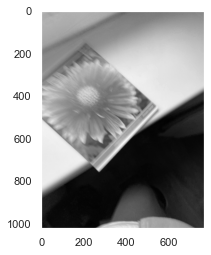

1


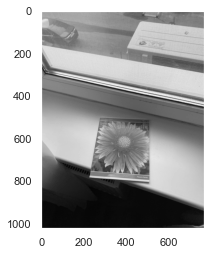

2


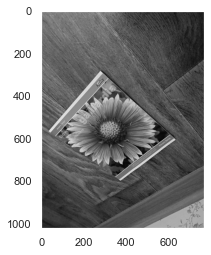

3


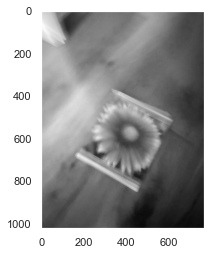

4


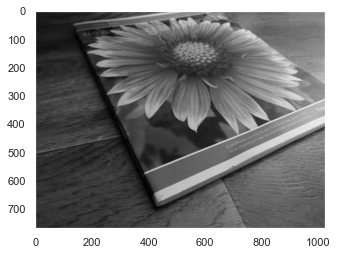

5


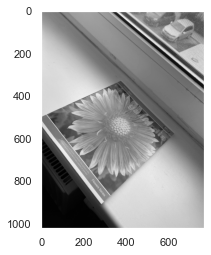

6


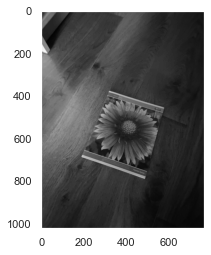

7


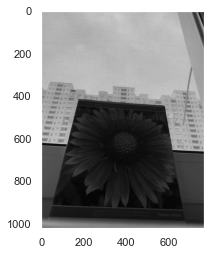

8


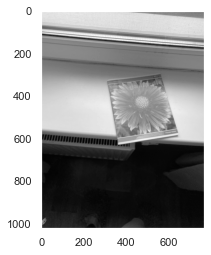

9


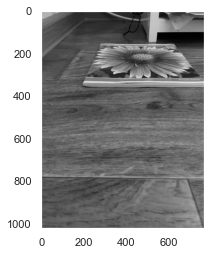

10


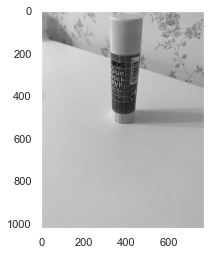

11


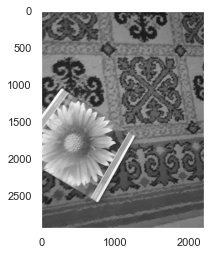

12


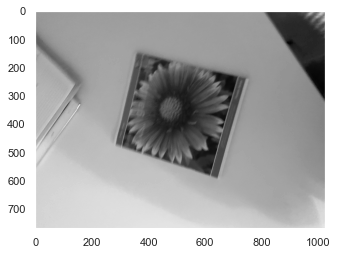

13


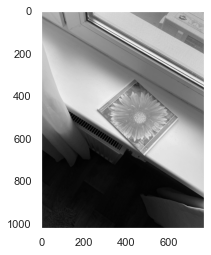

14


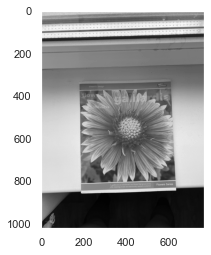

15


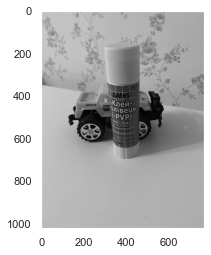

16


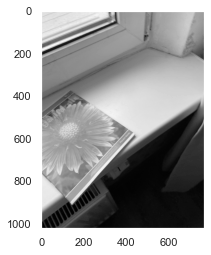

17


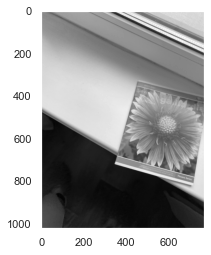

18


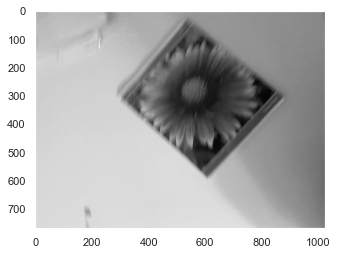

19


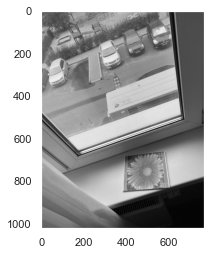

20


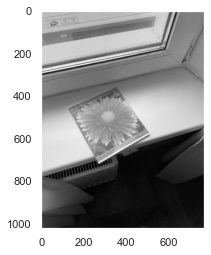

21


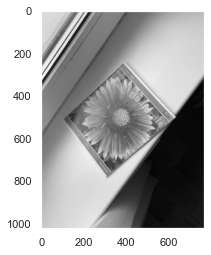

22


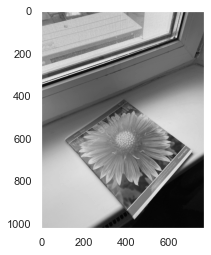

23


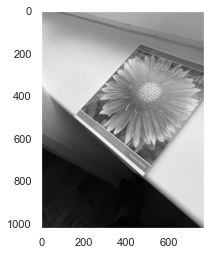

24


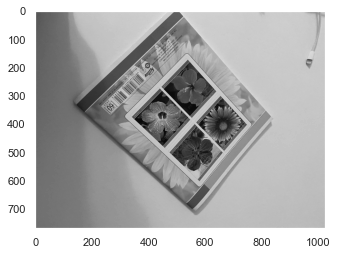

25


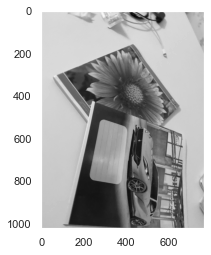

26


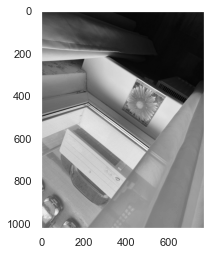

27


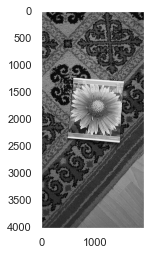

28


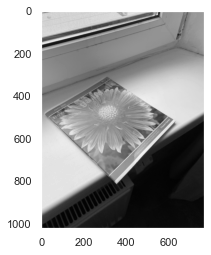

29


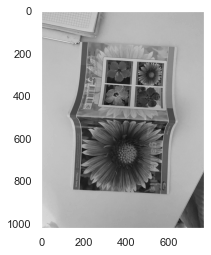

30


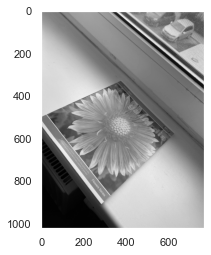

31


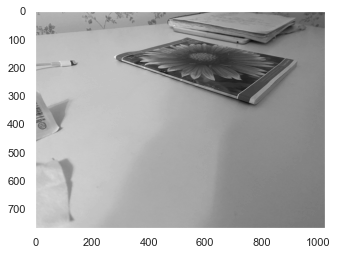

32


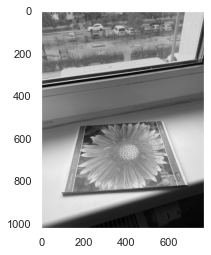

33


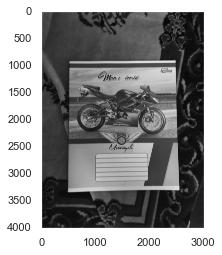

34


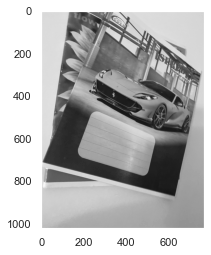

35


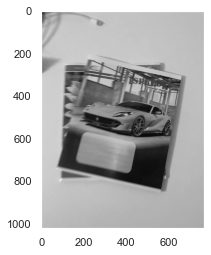

36


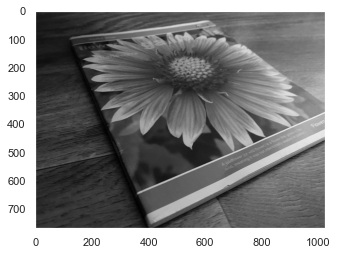

37


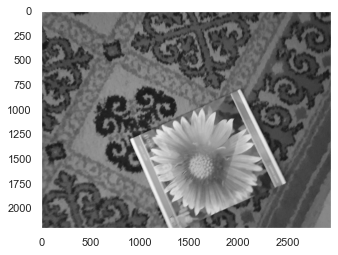

38


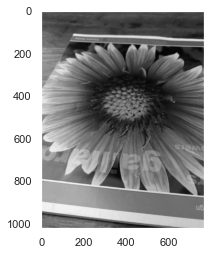

39


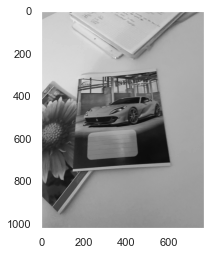

40


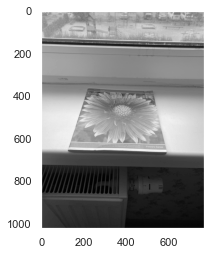

41


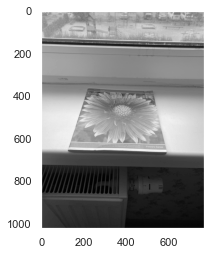

42


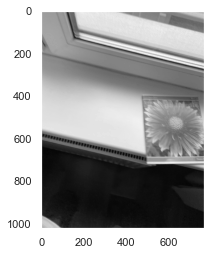

43


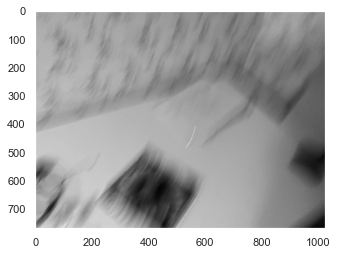

44


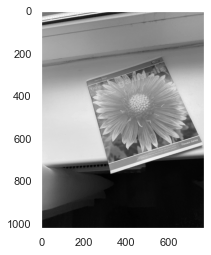

45


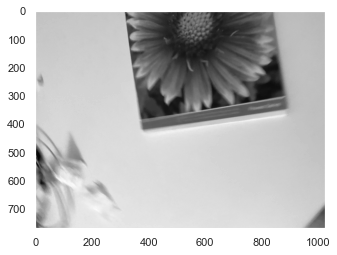

46


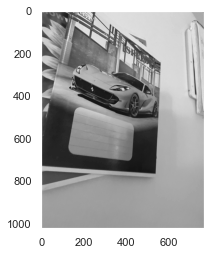

47


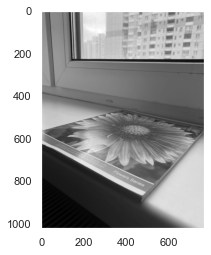

48


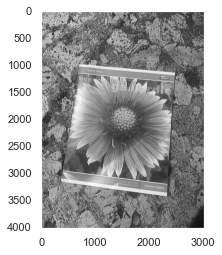

49


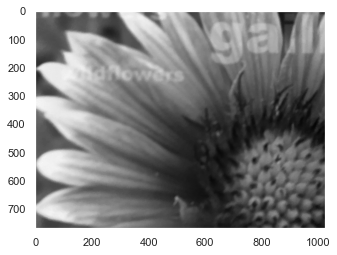

50


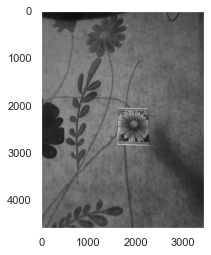

51


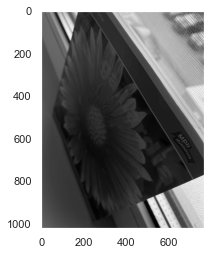

52


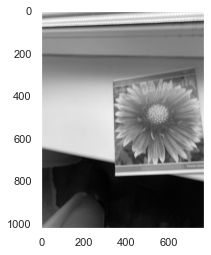

53


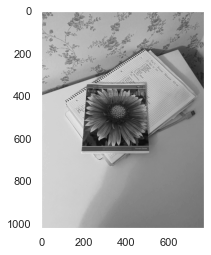

54


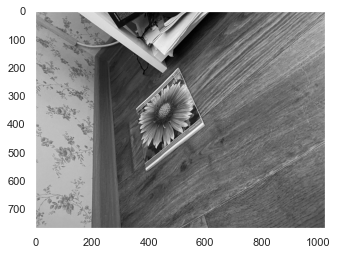

55


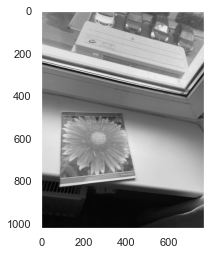

56


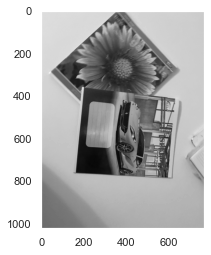

57


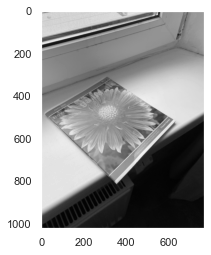

58


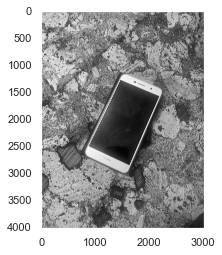

59


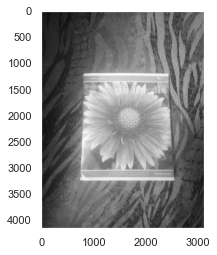

60


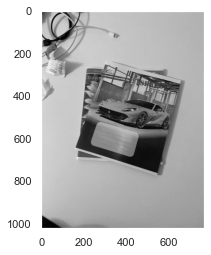

61


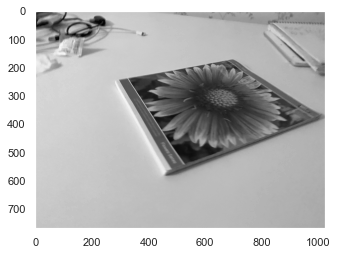

62


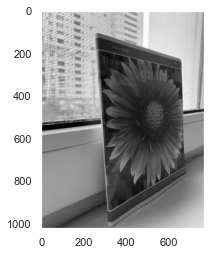

63


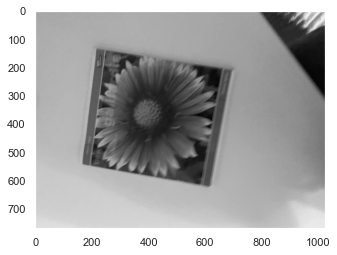

64


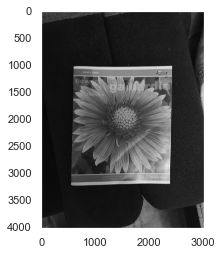

65


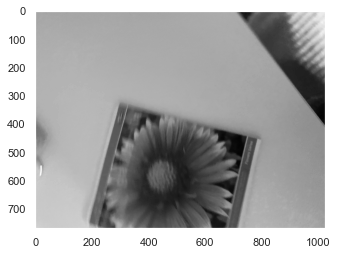

66


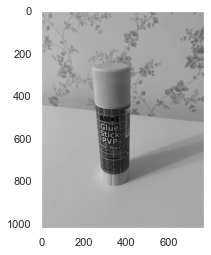

67


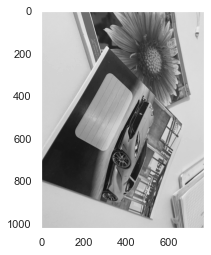

68


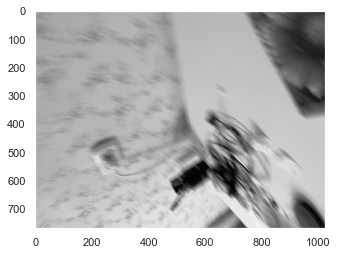

69


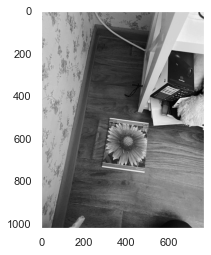

70


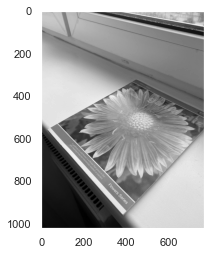

71


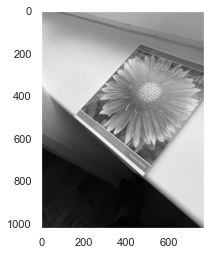

72


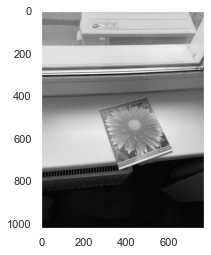

73


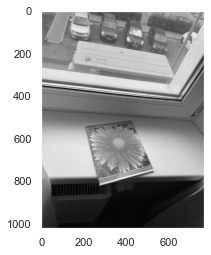

74


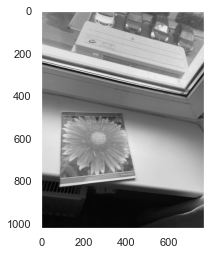

75


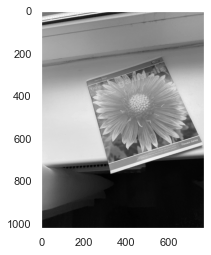

76


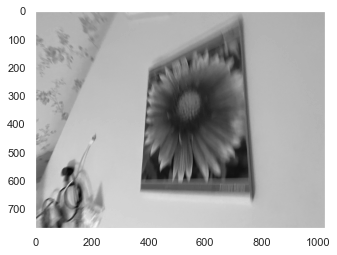

77


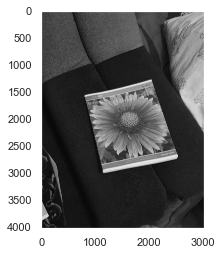

78


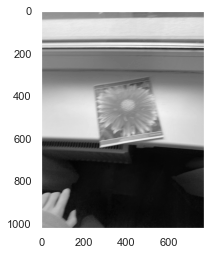

79


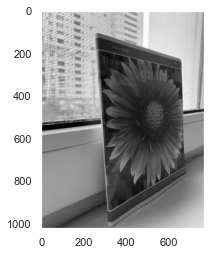

80


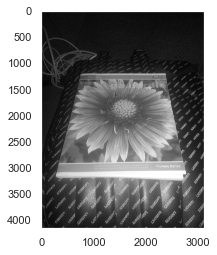

81


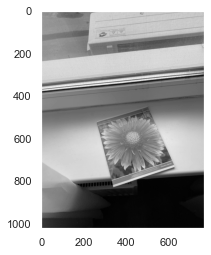

82


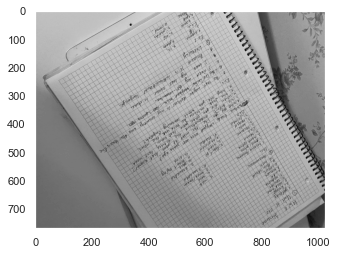

83


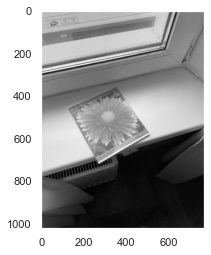

84


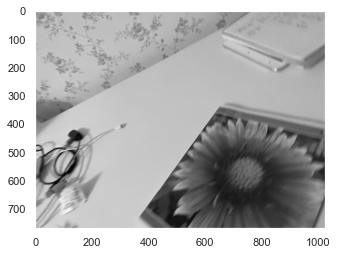

85


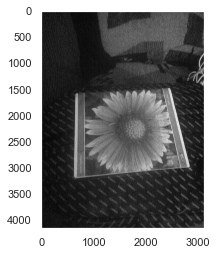

86


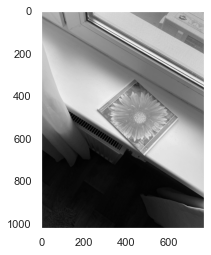

87


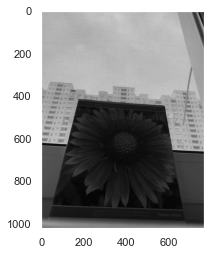

88


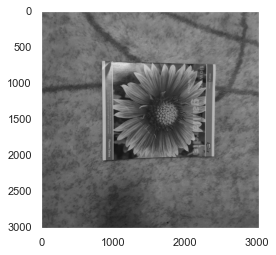

89


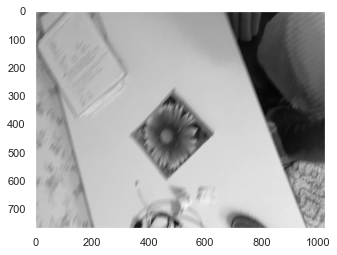

90


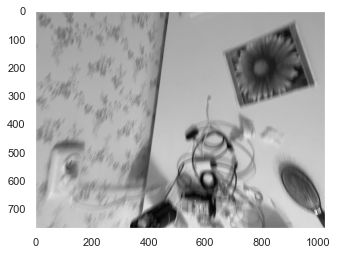

91


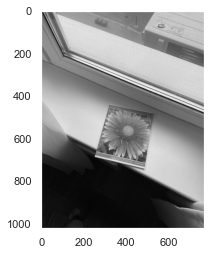

92


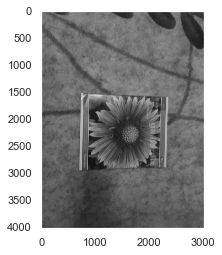

93


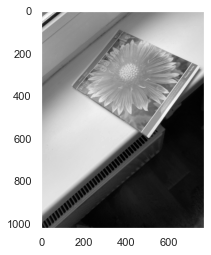

94


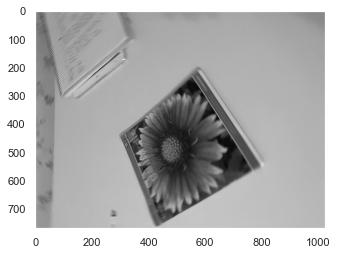

95


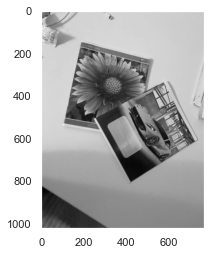

96


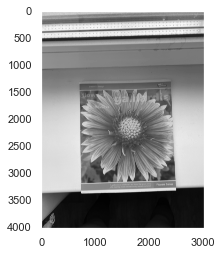

97


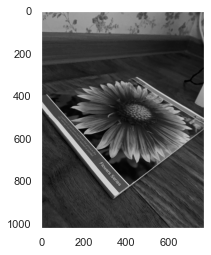

98


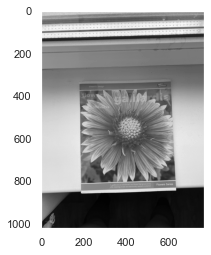

99


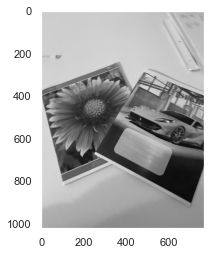

100


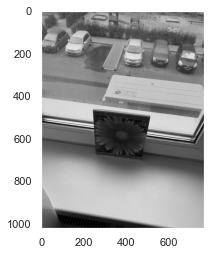

101


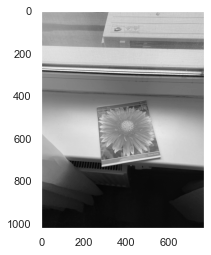

102


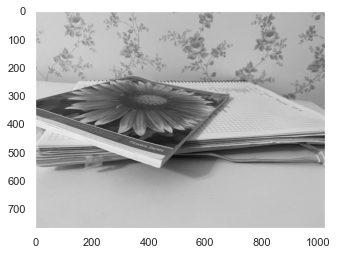

103


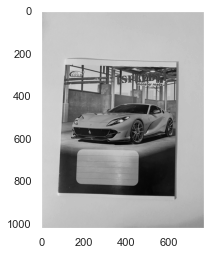

104


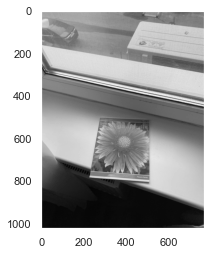

105


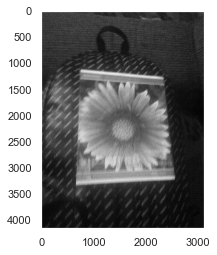

106


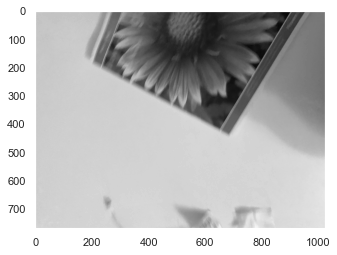

107


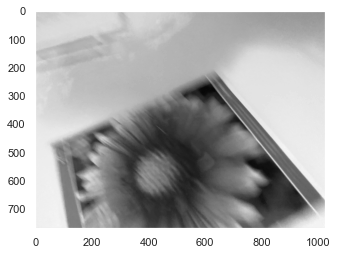

108


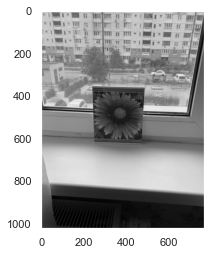

109


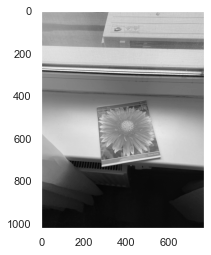

110


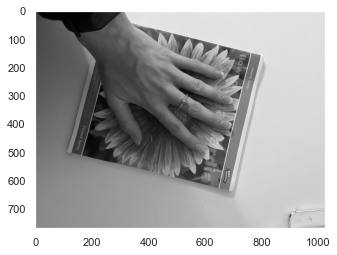

111


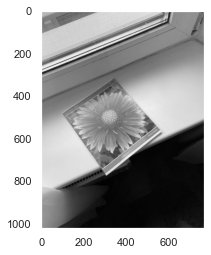

112


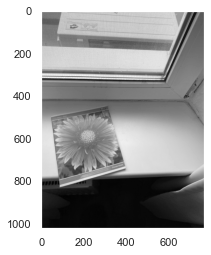

113


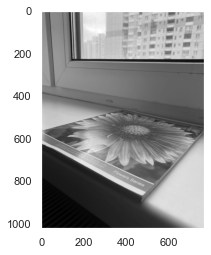

114


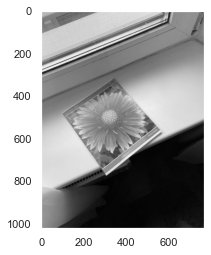

115


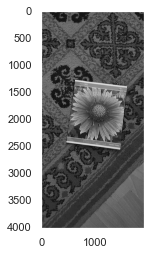

116


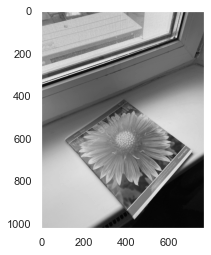

117


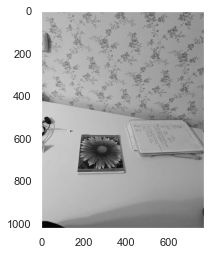

118


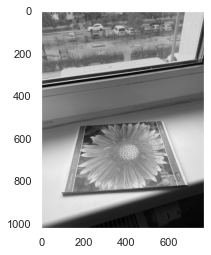

119


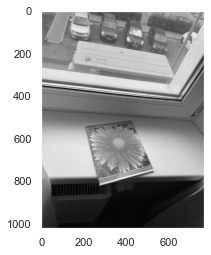

120


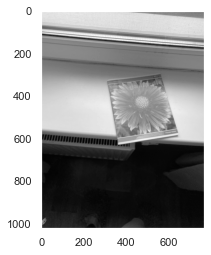

121


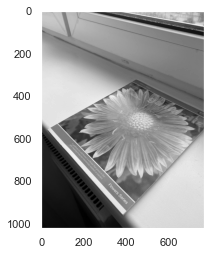

122


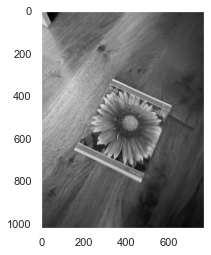

123


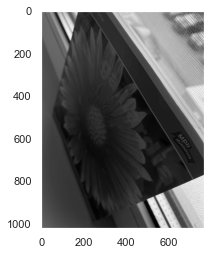

124


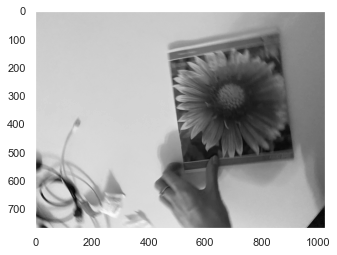

125


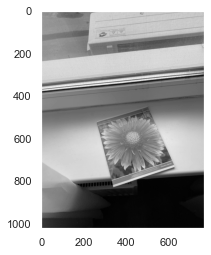

126


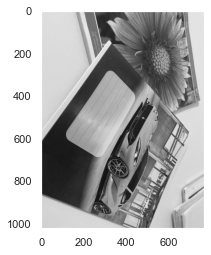

127


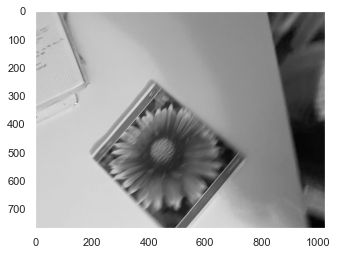

128


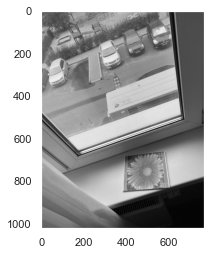

129


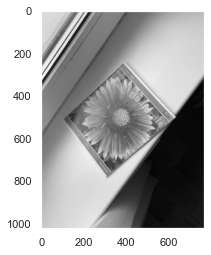

130


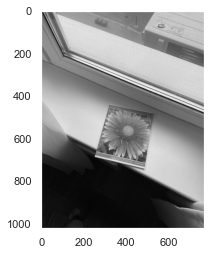

131


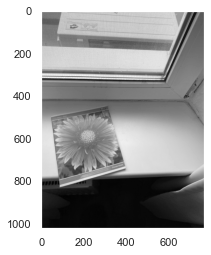

132


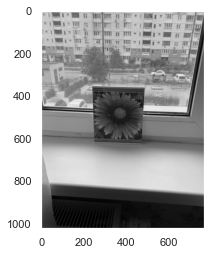

133


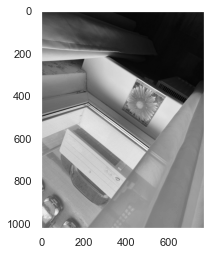

134


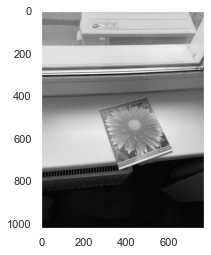

135


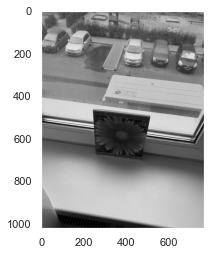

136


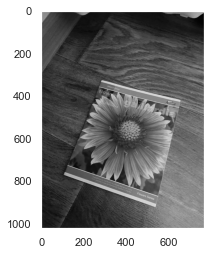

<Figure size 432x288 with 0 Axes>

In [6]:
sns.set()
with sns.axes_style({'axes.grid': False}):
    for idx, image in enumerate(images): 
        print(idx)
        plt.imshow(images[idx], 'gray'),plt.show()
        plt.figure(idx+1)

In [7]:
import itertools
import time
inliers_matches = dict()
indexes = list(itertools.product(alg_dict.keys(),["inliers/matches","distance MSE","time (s)"]))
for im_j_idx in range(len(images[:136])):
    inliers_matches["img"+str(im_j_idx)]=list()

In [8]:
from openpyxl import Workbook
workbook = Workbook()
sheet = workbook.active

sheet["A2"] = "algorithm"
sheet["B2"] = "property"
sheet["A3"] = "brisk"
sheet["B3"] = "inliers/matches"
sheet["C3"] = "distance MSE"
sheet["D3"] = "time (s)"
sheet["E3"] = "akaze"
sheet["F3"] = "inliers/matches"
sheet["G3"] = "distance MSE"
sheet["H3"] = "time (s)"
c = 3


for alg_name, alg in alg_dict.items():
    for im_i_idx, image_i in enumerate(images[:136]):
        time_start=time.monotonic()
        _, __, match, inlier ,msd = detect_match(algorithm=alg,query_img=image_i,train_img=images[98],
                                                     min_match_count=8)
        c = c + 1
        time_end=time.monotonic()
        if match==0:
            match=np.inf
        inliers_matches["img"+str(im_i_idx)].append(np.sum(inlier)/(len(match)))
        inliers_matches["img"+str(im_i_idx)].append(msd)
        inliers_matches["img"+str(im_i_idx)].append(time_end-time_start)
        if(alg_name == "brisk"):
            sheet[str("A"+str(c))] = str("img"+str(im_i_idx))
            sheet[str("B"+str(c))] = np.sum(inlier)/(len(match))
            sheet[str("C"+str(c))] = msd
            sheet[str("D"+str(c))] = time_end-time_start
        else:
            sheet[str("E"+str(c))] = str("img"+str(im_i_idx))
            sheet[str("F"+str(c))] = np.sum(inlier)/(len(match))
            sheet[str("G"+str(c))] = msd
            sheet[str("H"+str(c))] = time_end-time_start
            
workbook.save(filename="hello_world56.xlsx")


<ipython-input-8-acd133ca3e0b>:27: RuntimeWarning: invalid value encountered in long_scalars
  inliers_matches["img"+str(im_i_idx)].append(np.sum(inlier)/(len(match)))
<ipython-input-8-acd133ca3e0b>:32: RuntimeWarning: invalid value encountered in long_scalars
  sheet[str("B"+str(c))] = np.sum(inlier)/(len(match))
<ipython-input-8-acd133ca3e0b>:37: RuntimeWarning: invalid value encountered in long_scalars
  sheet[str("F"+str(c))] = np.sum(inlier)/(len(match))


In [9]:
import pandas as pd
index = pd.MultiIndex.from_tuples(indexes,names=['algorithm','property'])
comparison_df=pd.DataFrame(inliers_matches,index=index)

In [10]:
comparison_df

img0      img1      img2      img3      img4  \
algorithm property                                                            
brisk     inliers/matches  0.600000  0.568627  0.907216       NaN  0.000000   
          distance MSE     0.473370  0.606913  0.524548       inf       inf   
          time (s)         0.064088  0.114208  0.193554  0.057678  0.076007   
akaze     inliers/matches  0.645161  0.952381  0.916667       NaN  0.000000   
          distance MSE     0.452492  0.588786  0.522518       inf       inf   
          time (s)         0.272354  0.272806  0.283943  0.260915  0.292960   

                               img5      img6      img7      img8      img9  \
algorithm property                                                            
brisk     inliers/matches  0.923077  0.827586  0.000000  0.440678  0.000000   
          distance MSE     0.691597  0.401982       inf  0.549098       inf   
          time (s)         0.179963  0.073010  0.291177  0.077577  0.137752   
akaze     inliers/matches  0.823529  0.925926  0.000000  0.866667  0.000000   
          distance MSE     0.666425  0.411797       inf  0.349160       inf   
          time (s)         0.274195  0.265763  0.266252  0.268193  0.272002   

                           ...    img126    img127    img128    img129  \
algorithm property         ...                                           
brisk     inliers/matches  ...  0.000000  0.000000  0.533333  0.945205   
          distance MSE     ...       inf       inf  1.673821  0.505393   
          time (s)         ...  0.196240  0.067581  0.219015  0.129795   
akaze     inliers/matches  ...  0.000000  0.733333  0.000000  0.974359   
          distance MSE     ...       inf  0.431481       inf  0.505004   
          time (s)         ...  0.306596  0.268087  0.284933  0.298995   

                             img130    img131    img132    img133    img134  \
algorithm property                                                            
brisk     inliers/matches  0.750000  0.618182  0.714286  0.736842  0.362637   
          distance MSE     0.584720  0.560327  0.575176  2.172908  0.555747   
          time (s)         0.096974  0.145105  0.373798  0.135401  0.089349   
akaze     inliers/matches  0.986842  0.913043  1.000000  0.882353  0.875000   
          distance MSE     0.586370  0.511933  0.586142  2.111266  0.618217   
          time (s)         0.288091  0.283388  0.296343  0.268505  0.274316   

                              img135  
algorithm property                    
brisk     inliers/matches   0.241379  
          distance MSE     10.404197  
          time (s)          0.317710  
akaze     inliers/matches   0.000000  
          distance MSE           inf  
          time (s)          0.277279  

[6 rows x 136 columns]

In [11]:
best_inliers = {descr:{int(k[3:]):np.round(v,2) for k,v in zip(
                comparison_df.drop(columns=['img98']).loc[descr].sort_values(by=['inliers/matches'],axis=1,
                                    ascending=False).loc['inliers/matches'].index.values,
                 comparison_df.drop(columns=['img98']).loc[descr].sort_values(by=['inliers/matches'],axis=1,
                                     ascending=False).loc['inliers/matches'].values) if v>=0.5} for descr in alg_dict.keys()}


In [12]:
ids = set(best_inliers['akaze'].keys())
ids_2 = set(best_inliers['brisk'].keys())
diference = ids.difference(ids_2)
ids.update(best_inliers['brisk'].keys())

In [13]:
def showresult(id_image, algorithm):
    keypoints1, keypoints2, good_matches, matchesMask, _ = detect_match(algorithm=algorithm,query_img=images[id_image],train_img=images[98],
                                                     min_match_count=10)
    img3=plot_match(query_img=images[id_image], keypoints1=keypoints1,train_img=images[98],  keypoints2=keypoints2, good_matches=good_matches, matchesMask=matchesMask)
    plt.show(img3)

0
brisk


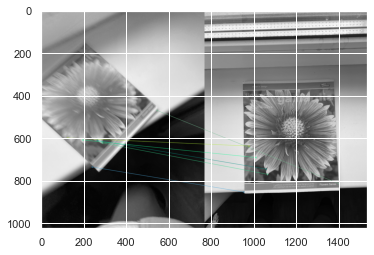

<Figure size 432x288 with 0 Axes>

0
akaze


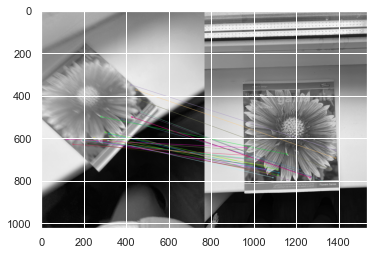

<Figure size 432x288 with 0 Axes>

1
brisk


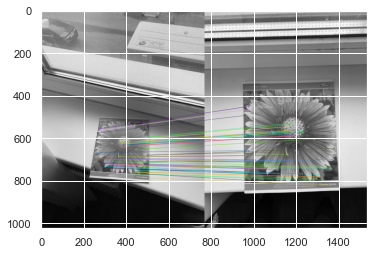

<Figure size 432x288 with 0 Axes>

1
akaze


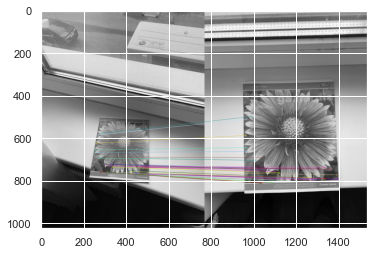

<Figure size 432x288 with 0 Axes>

2
brisk


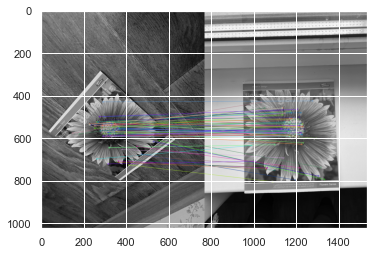

<Figure size 432x288 with 0 Axes>

2
akaze


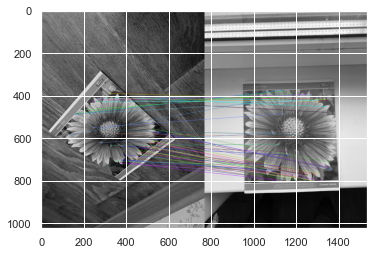

<Figure size 432x288 with 0 Axes>

5
brisk


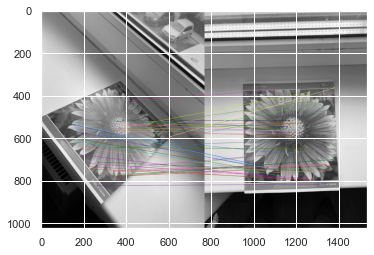

<Figure size 432x288 with 0 Axes>

5
akaze


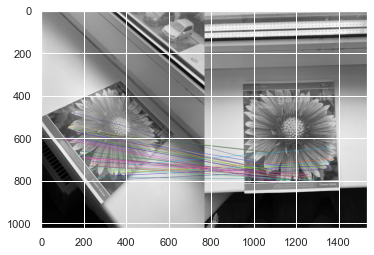

<Figure size 432x288 with 0 Axes>

6
brisk


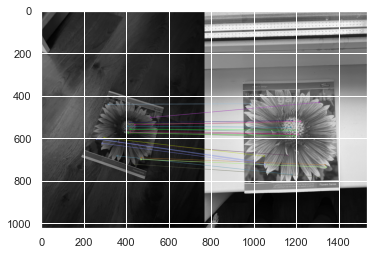

<Figure size 432x288 with 0 Axes>

6
akaze


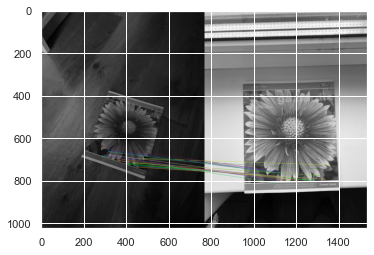

<Figure size 432x288 with 0 Axes>

8
brisk


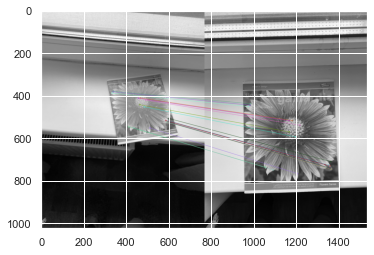

<Figure size 432x288 with 0 Axes>

8
akaze


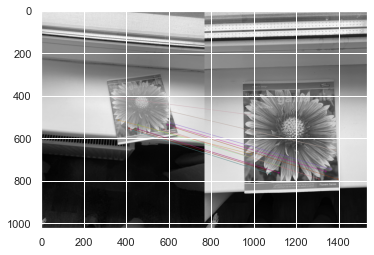

<Figure size 432x288 with 0 Axes>

12
brisk


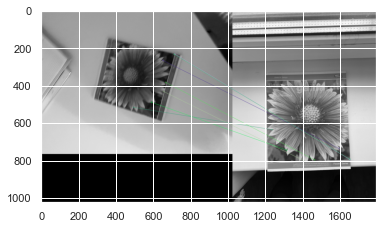

<Figure size 432x288 with 0 Axes>

12
akaze


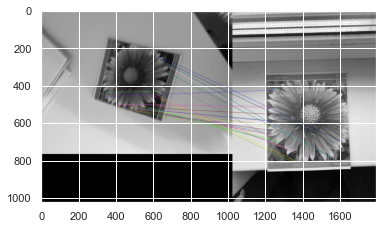

<Figure size 432x288 with 0 Axes>

14
brisk


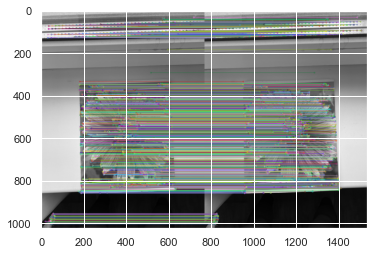

<Figure size 432x288 with 0 Axes>

14
akaze


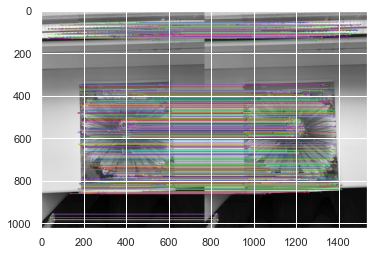

<Figure size 432x288 with 0 Axes>

16
brisk


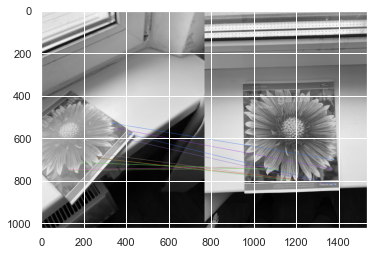

<Figure size 432x288 with 0 Axes>

16
akaze


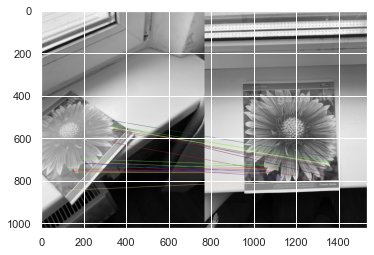

<Figure size 432x288 with 0 Axes>

17
brisk


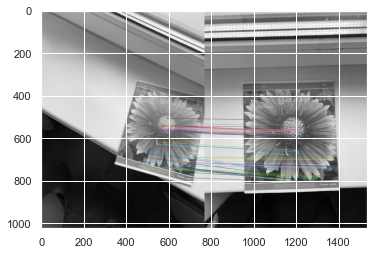

<Figure size 432x288 with 0 Axes>

17
akaze


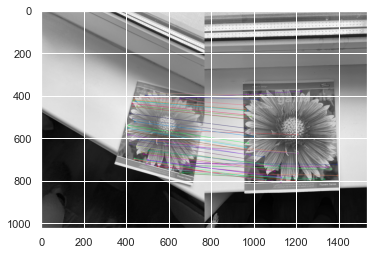

<Figure size 432x288 with 0 Axes>

20
brisk


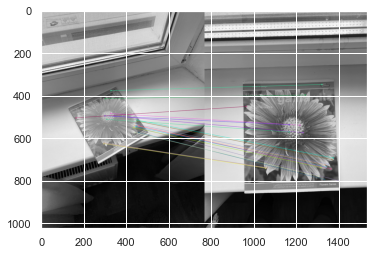

<Figure size 432x288 with 0 Axes>

20
akaze


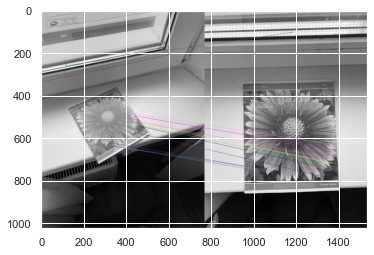

<Figure size 432x288 with 0 Axes>

21
brisk


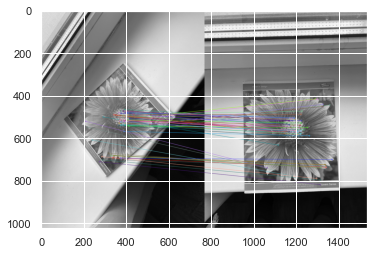

<Figure size 432x288 with 0 Axes>

21
akaze


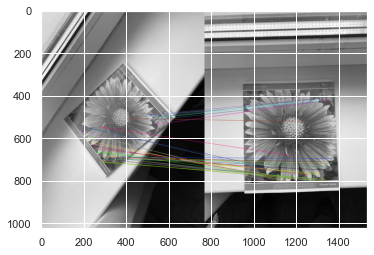

<Figure size 432x288 with 0 Axes>

22
brisk


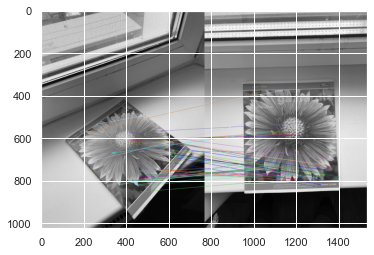

<Figure size 432x288 with 0 Axes>

22
akaze


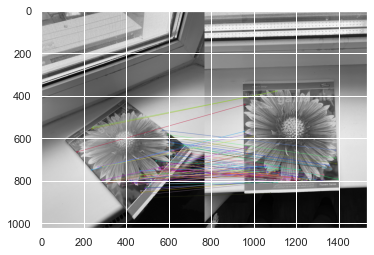

<Figure size 432x288 with 0 Axes>

23
brisk


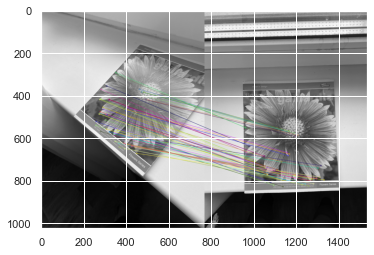

<Figure size 432x288 with 0 Axes>

23
akaze


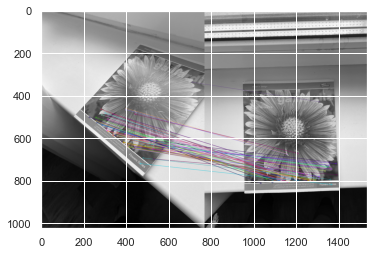

<Figure size 432x288 with 0 Axes>

24
brisk


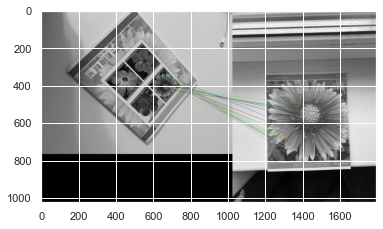

<Figure size 432x288 with 0 Axes>

24
akaze


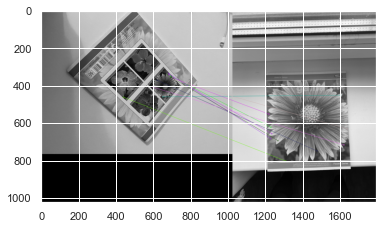

<Figure size 432x288 with 0 Axes>

25
brisk


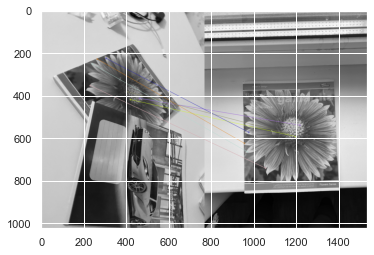

<Figure size 432x288 with 0 Axes>

25
akaze


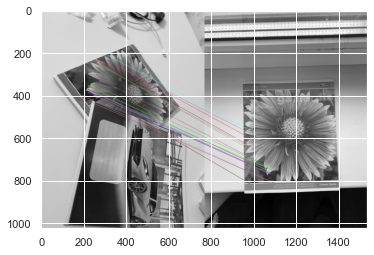

<Figure size 432x288 with 0 Axes>

26
brisk


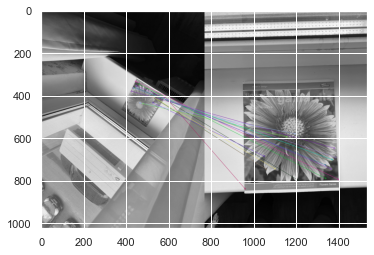

<Figure size 432x288 with 0 Axes>

26
akaze


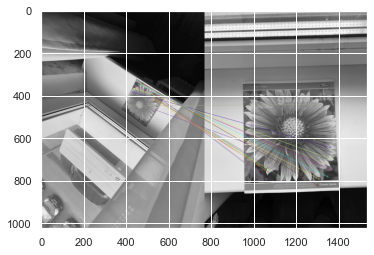

<Figure size 432x288 with 0 Axes>

27
brisk


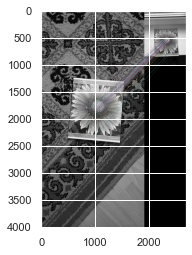

<Figure size 432x288 with 0 Axes>

27
akaze


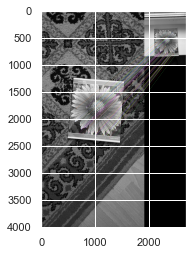

<Figure size 432x288 with 0 Axes>

28
brisk


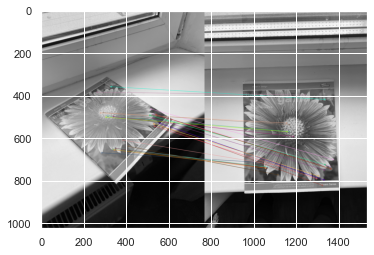

<Figure size 432x288 with 0 Axes>

28
akaze


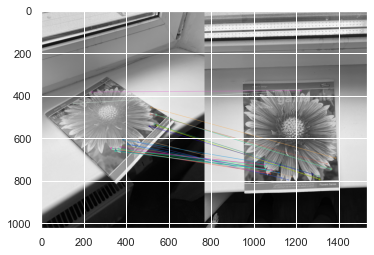

<Figure size 432x288 with 0 Axes>

29
brisk


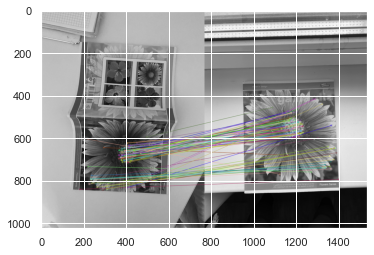

<Figure size 432x288 with 0 Axes>

29
akaze


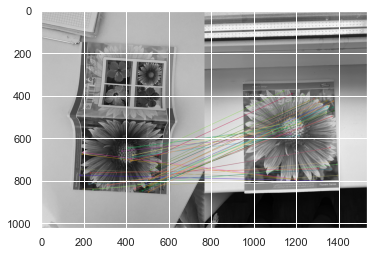

<Figure size 432x288 with 0 Axes>

30
brisk


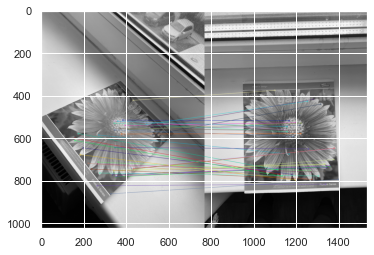

<Figure size 432x288 with 0 Axes>

30
akaze


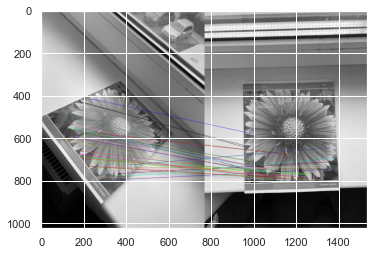

<Figure size 432x288 with 0 Axes>

32
brisk


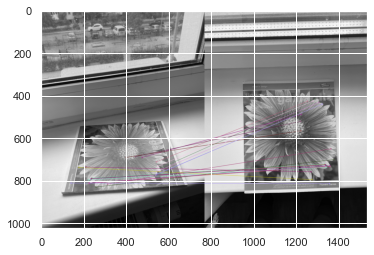

<Figure size 432x288 with 0 Axes>

32
akaze


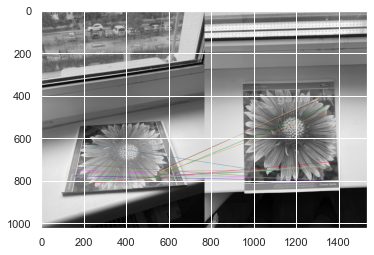

<Figure size 432x288 with 0 Axes>

33
brisk


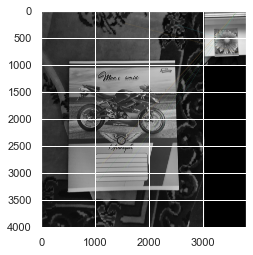

<Figure size 432x288 with 0 Axes>

33
akaze


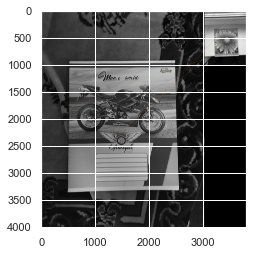

<Figure size 432x288 with 0 Axes>

34
brisk


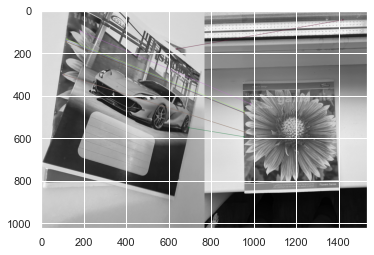

<Figure size 432x288 with 0 Axes>

34
akaze


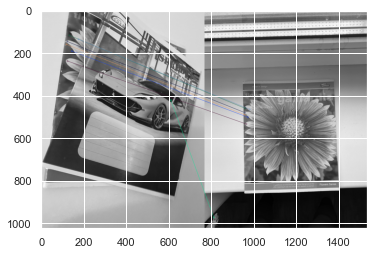

<Figure size 432x288 with 0 Axes>

38
brisk


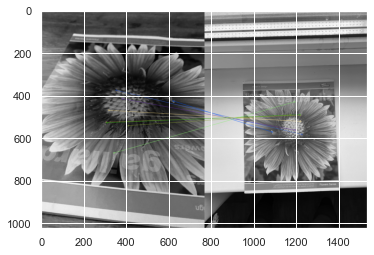

<Figure size 432x288 with 0 Axes>

38
akaze


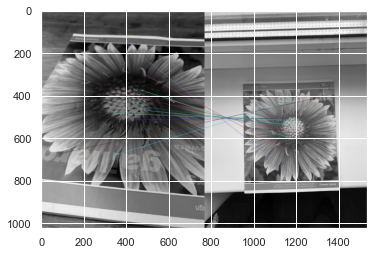

<Figure size 432x288 with 0 Axes>

39
brisk


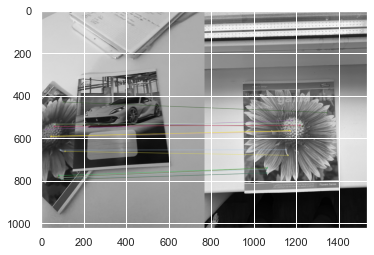

<Figure size 432x288 with 0 Axes>

39
akaze


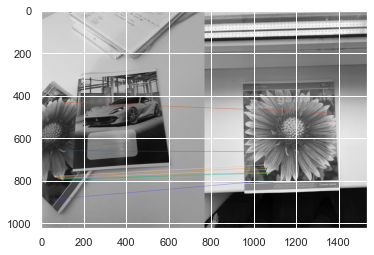

<Figure size 432x288 with 0 Axes>

41
brisk


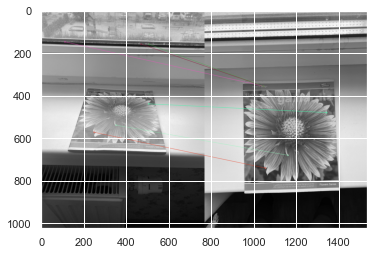

<Figure size 432x288 with 0 Axes>

41
akaze


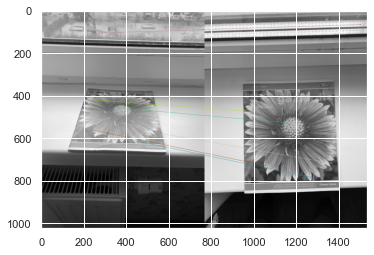

<Figure size 432x288 with 0 Axes>

42
brisk


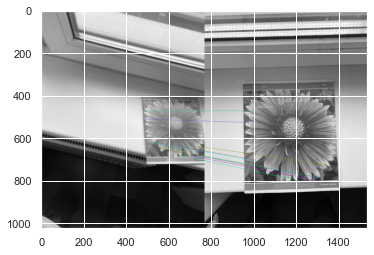

<Figure size 432x288 with 0 Axes>

42
akaze


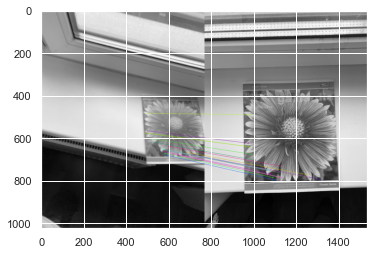

<Figure size 432x288 with 0 Axes>

44
brisk


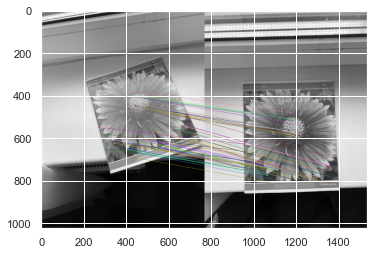

<Figure size 432x288 with 0 Axes>

44
akaze


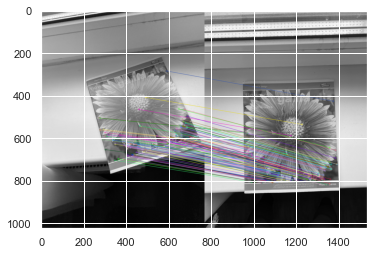

<Figure size 432x288 with 0 Axes>

45
brisk


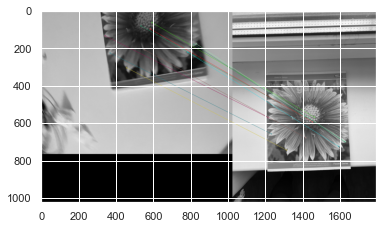

<Figure size 432x288 with 0 Axes>

45
akaze


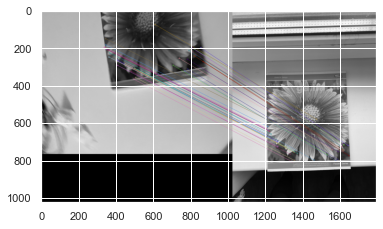

<Figure size 432x288 with 0 Axes>

48
brisk


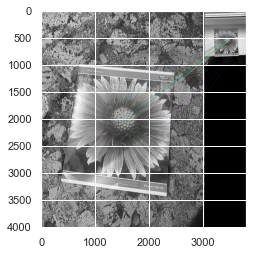

<Figure size 432x288 with 0 Axes>

48
akaze


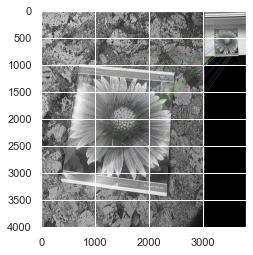

<Figure size 432x288 with 0 Axes>

49
brisk


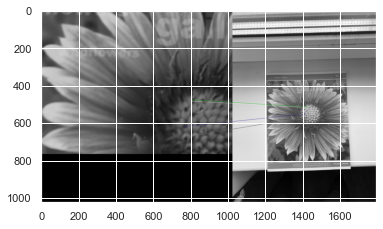

<Figure size 432x288 with 0 Axes>

49
akaze


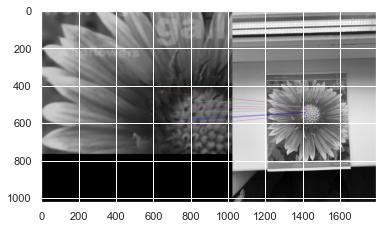

<Figure size 432x288 with 0 Axes>

50
brisk


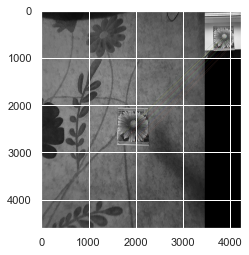

<Figure size 432x288 with 0 Axes>

50
akaze


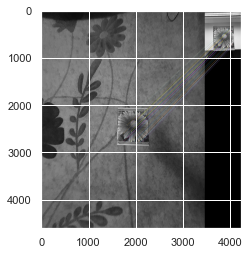

<Figure size 432x288 with 0 Axes>

52
brisk


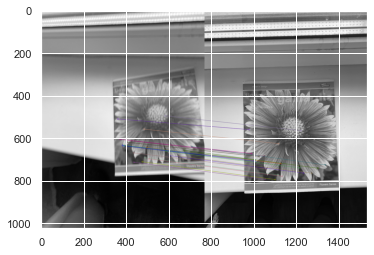

<Figure size 432x288 with 0 Axes>

52
akaze


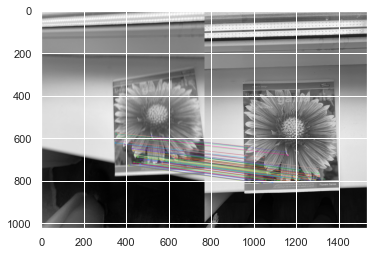

<Figure size 432x288 with 0 Axes>

53
brisk


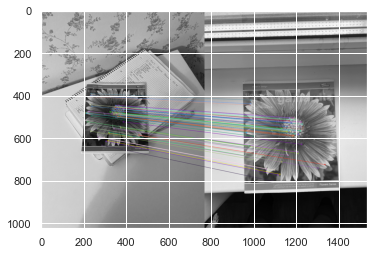

<Figure size 432x288 with 0 Axes>

53
akaze


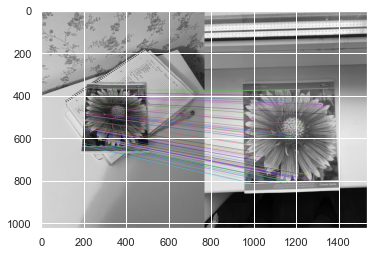

<Figure size 432x288 with 0 Axes>

55
brisk


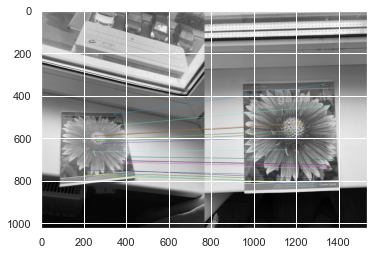

<Figure size 432x288 with 0 Axes>

55
akaze


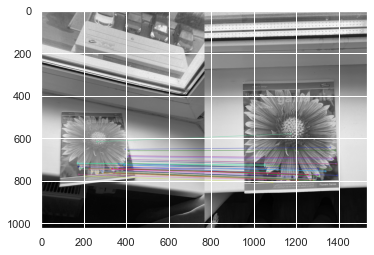

<Figure size 432x288 with 0 Axes>

56
brisk


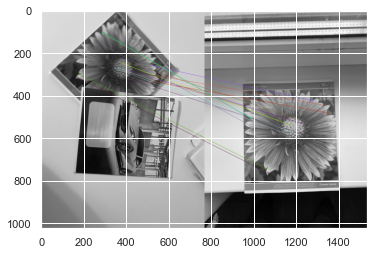

<Figure size 432x288 with 0 Axes>

56
akaze


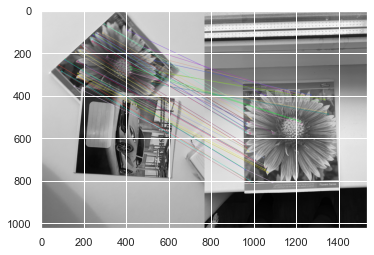

<Figure size 432x288 with 0 Axes>

57
brisk


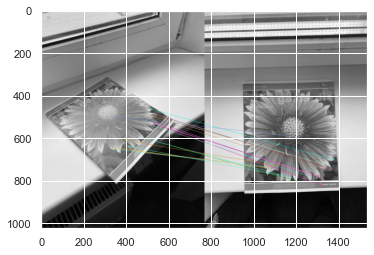

<Figure size 432x288 with 0 Axes>

57
akaze


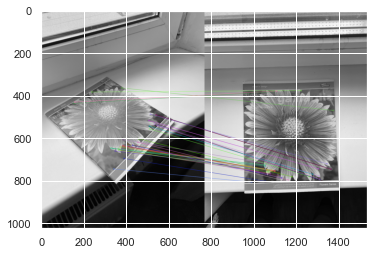

<Figure size 432x288 with 0 Axes>

59
brisk


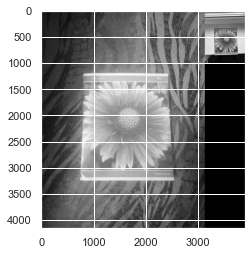

<Figure size 432x288 with 0 Axes>

59
akaze


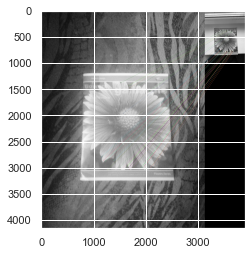

<Figure size 432x288 with 0 Axes>

60
brisk


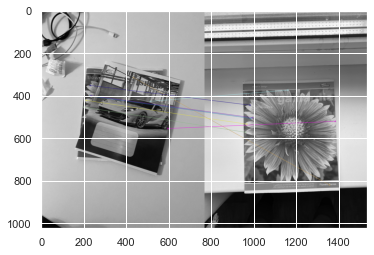

<Figure size 432x288 with 0 Axes>

60
akaze


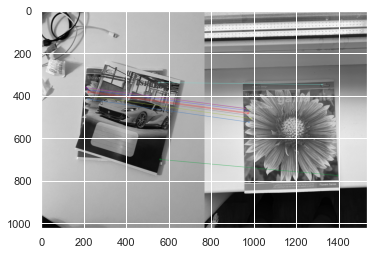

<Figure size 432x288 with 0 Axes>

61
brisk


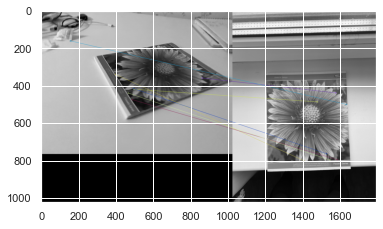

<Figure size 432x288 with 0 Axes>

61
akaze


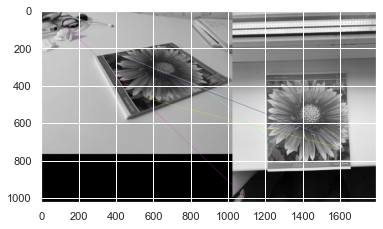

<Figure size 432x288 with 0 Axes>

62
brisk


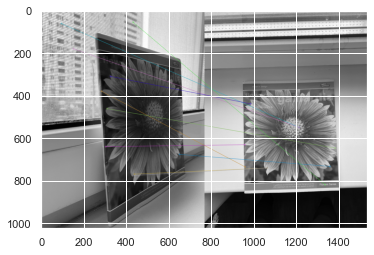

<Figure size 432x288 with 0 Axes>

62
akaze


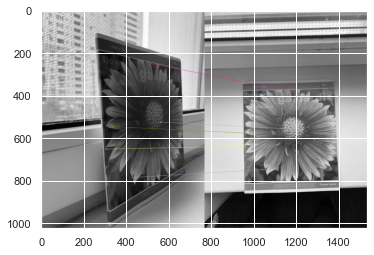

<Figure size 432x288 with 0 Axes>

63
brisk


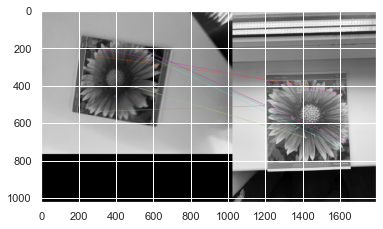

<Figure size 432x288 with 0 Axes>

63
akaze


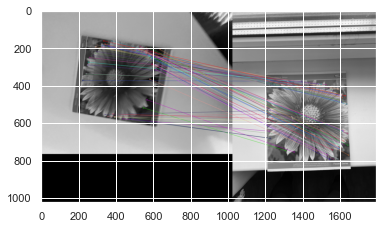

<Figure size 432x288 with 0 Axes>

64
brisk


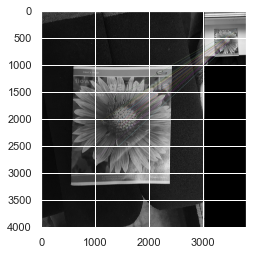

<Figure size 432x288 with 0 Axes>

64
akaze


KeyboardInterrupt: 

In [14]:
for i in ids:
    for alg_name, alg in alg_dict.items():
        print(i)
        print(alg_name)
        showresult(i,alg) 
    

In [ ]:
for i in diference:
    for alg_name, alg in alg_dict.items():
        print(i)
        print(alg_name)
        showresult(i,alg)  

### Подивимося на все 

In [ ]:
for i in best_inliers['akaze'].keys() : 
    for alg_name, alg in alg_dict.items():
        print(i)
        print(alg_name)
        showresult(i,alg)  

### Другий фотосет - машинка

In [20]:
sec_data_folder = os.path.join(os.curdir,'car')
sec_data_set = [os.path.join(sec_data_folder,file) for file in os.listdir(sec_data_folder) if os.path.isfile(os.path.join(sec_data_folder,file))and os.path.splitext(os.path.join(data_folder,file))[1].lower() in ('.jpg', '.jpeg')]

0


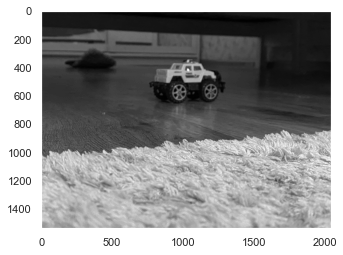

1


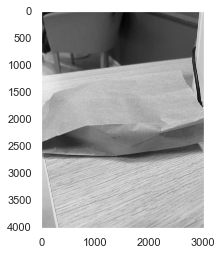

2


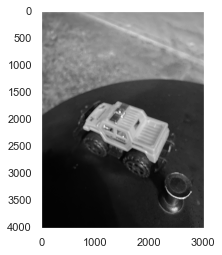

3


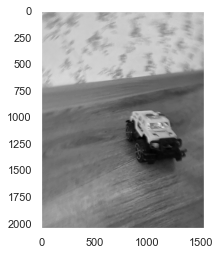

4


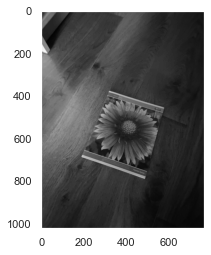

5


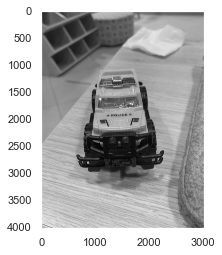

6


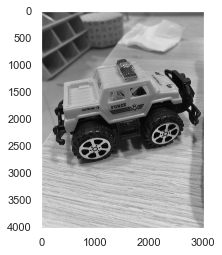

7


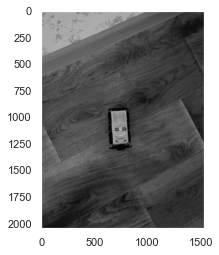

8


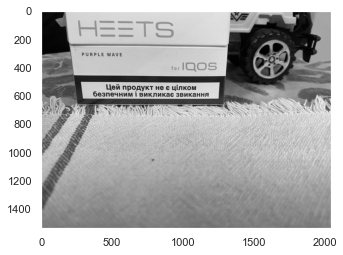

9


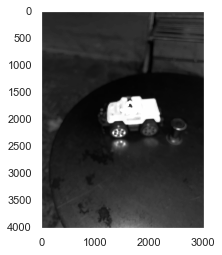

10


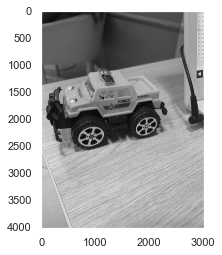

11


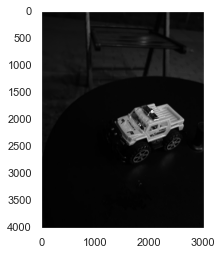

12


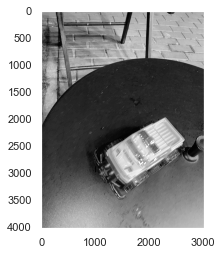

13


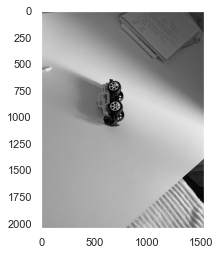

14


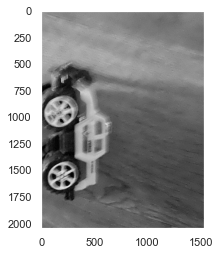

15


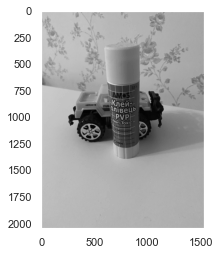

16


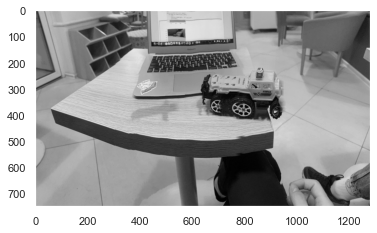

17


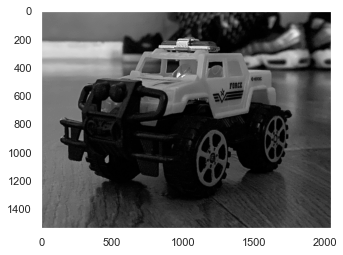

18


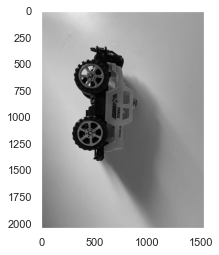

19


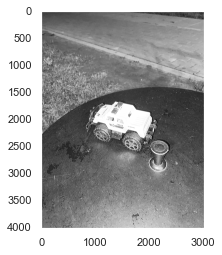

20


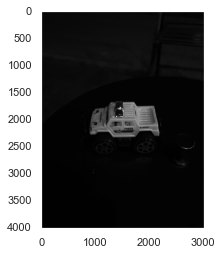

21


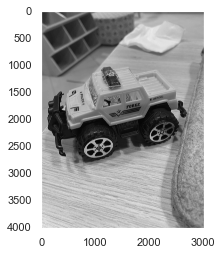

22


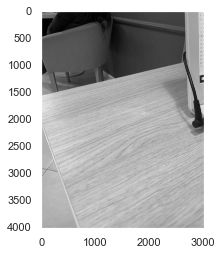

23


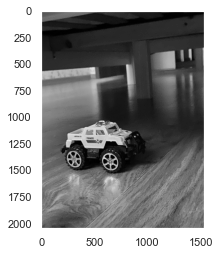

24


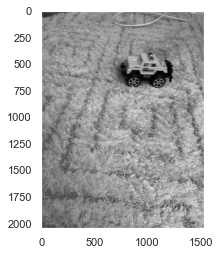

25


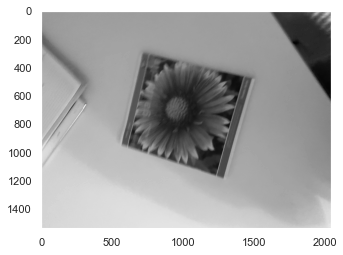

26


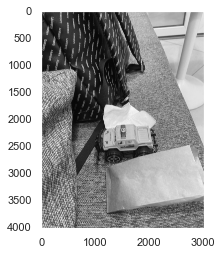

27


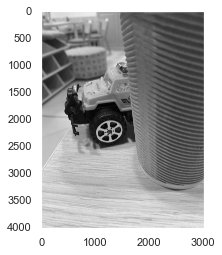

28


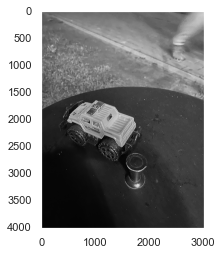

29


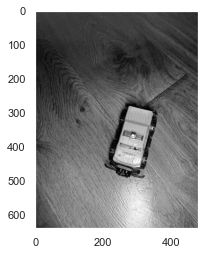

30


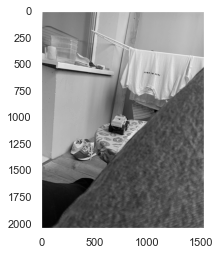

31


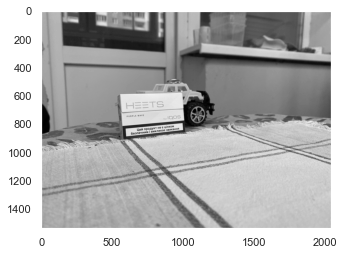

32


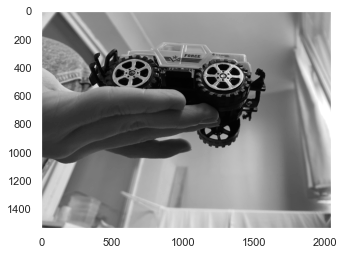

33


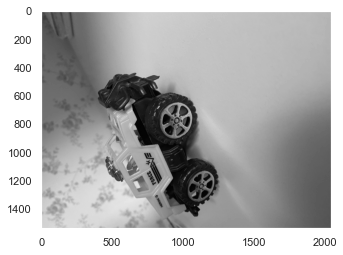

34


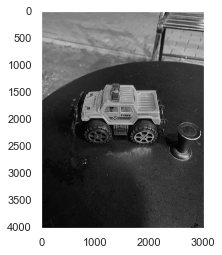

35


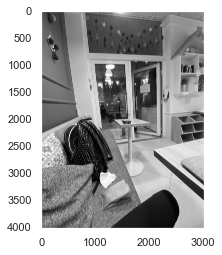

36


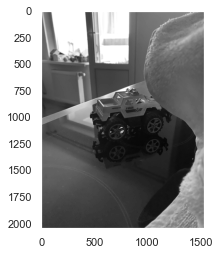

37


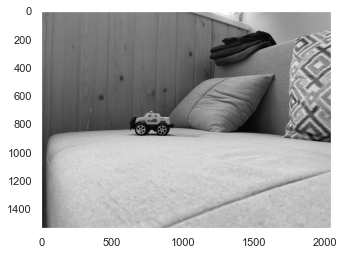

38


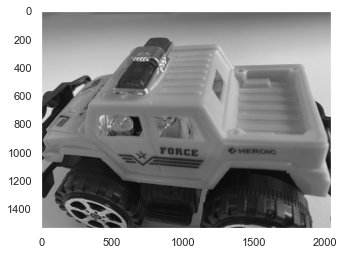

39


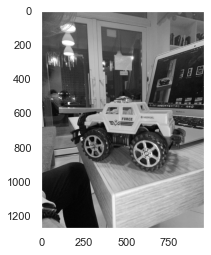

40


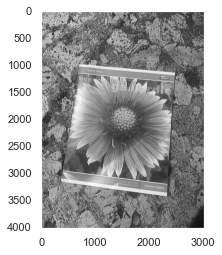

41


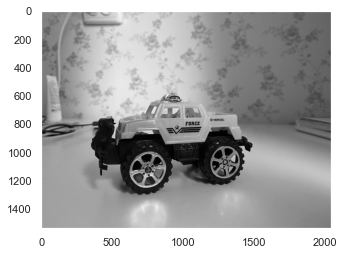

42


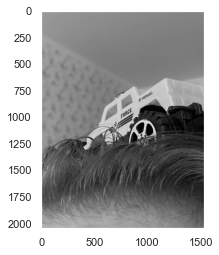

43


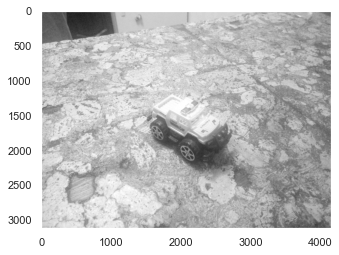

44


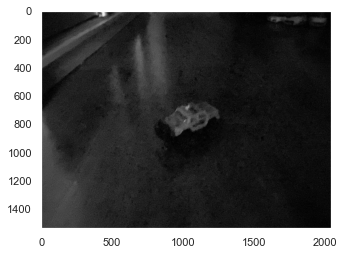

45


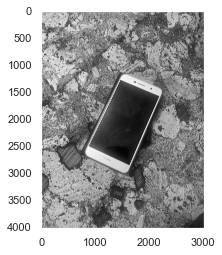

46


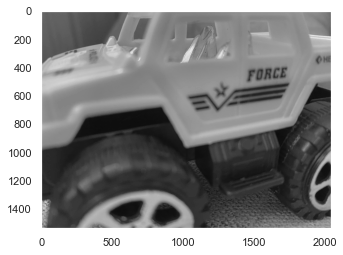

47


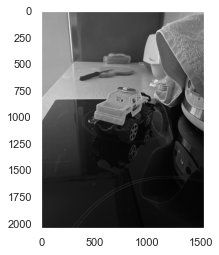

48


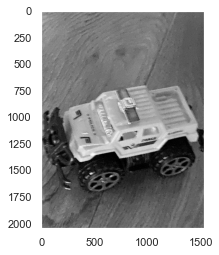

49


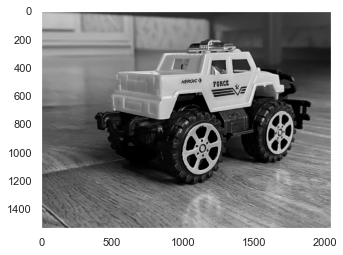

50


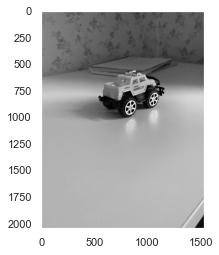

51


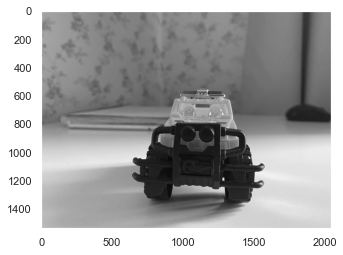

52


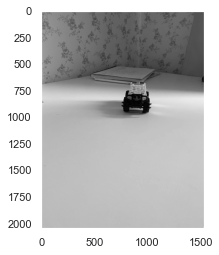

53


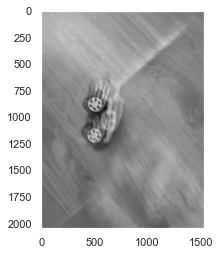

54


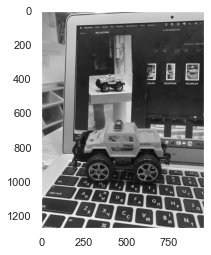

55


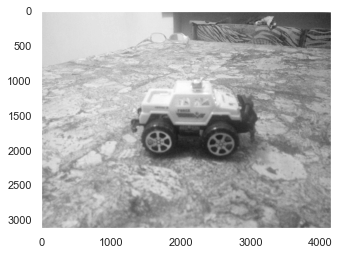

56


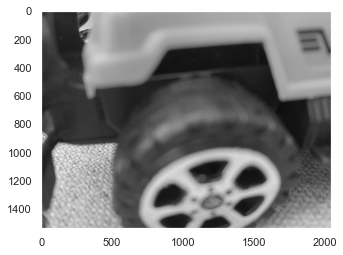

57


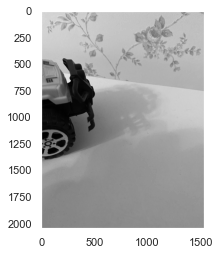

58


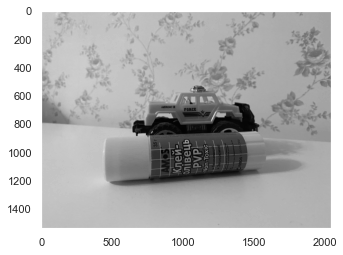

59


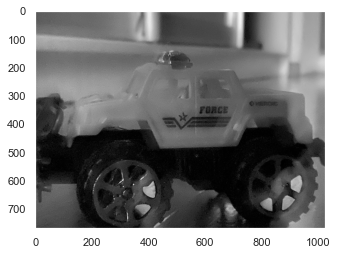

60


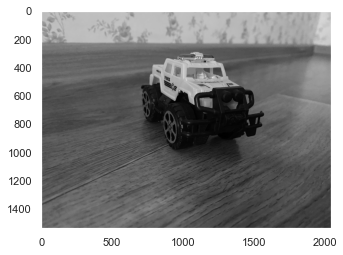

61


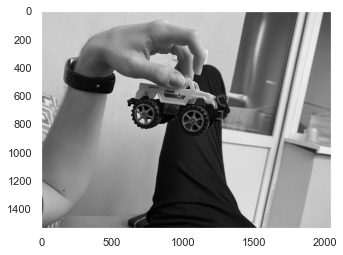

62


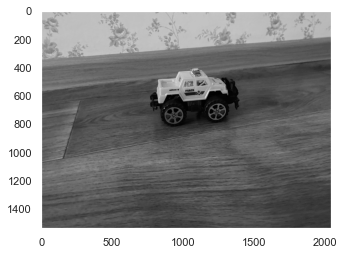

63


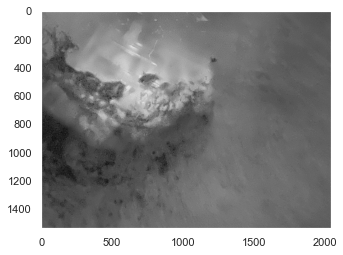

64


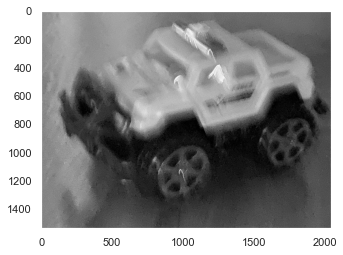

65


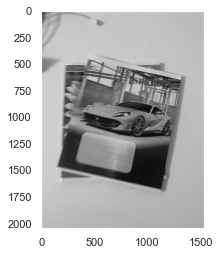

66


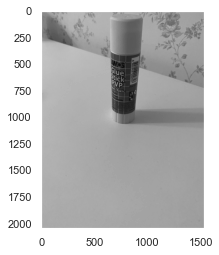

67


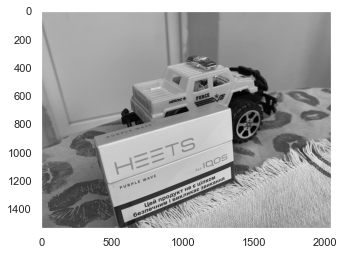

68


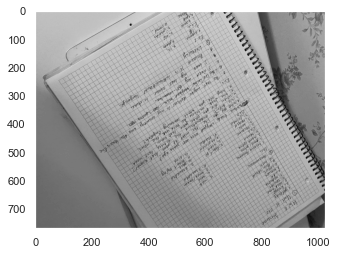

69


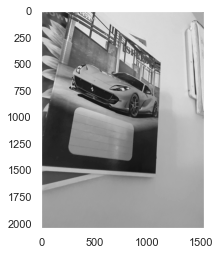

70


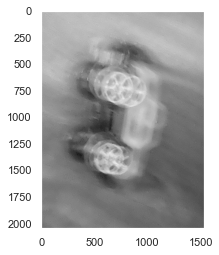

71


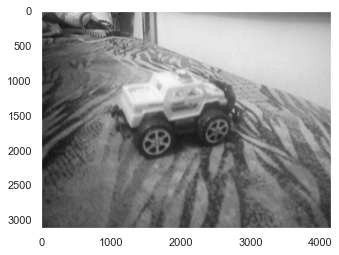

72


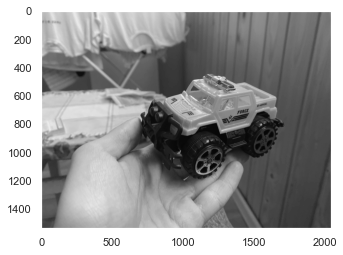

73


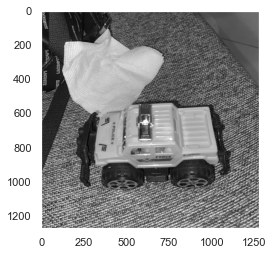

74


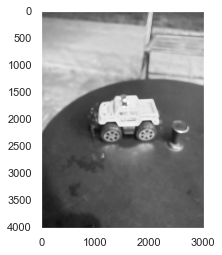

75


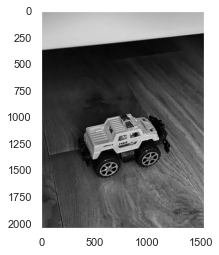

76


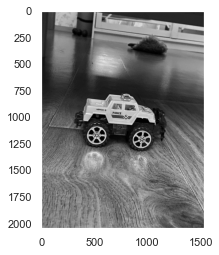

77


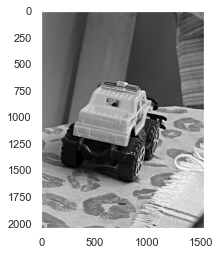

78


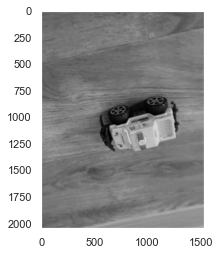

79


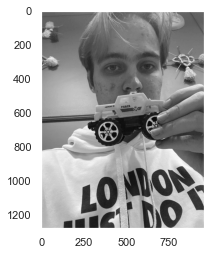

80


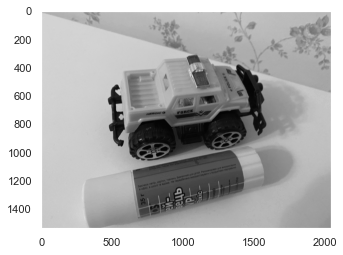

81


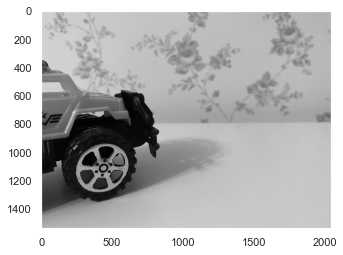

82


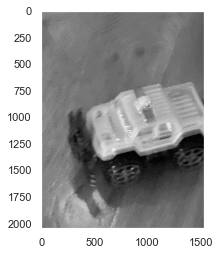

83


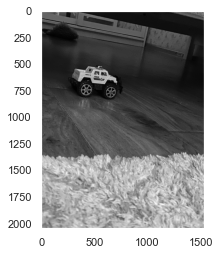

84


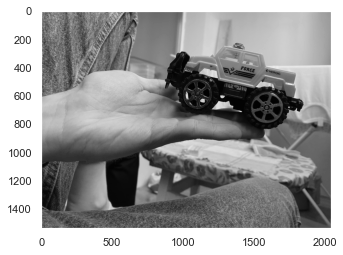

85


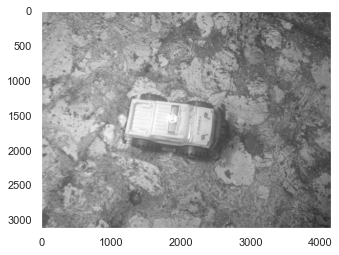

86


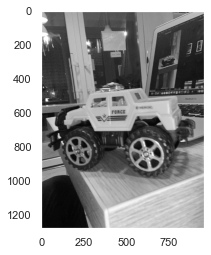

87


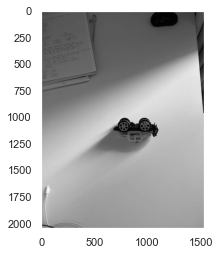

88


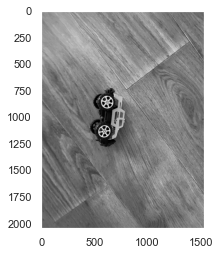

89


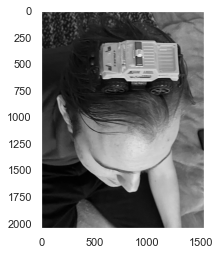

90


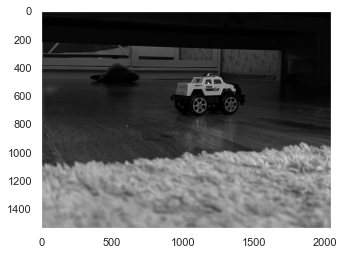

91


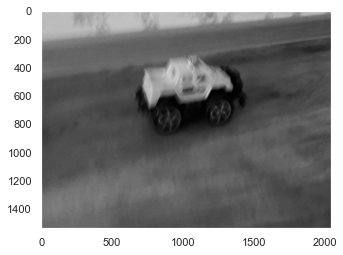

92


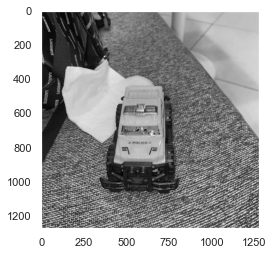

93


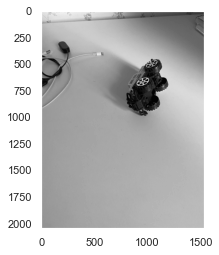

94


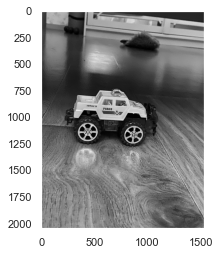

95


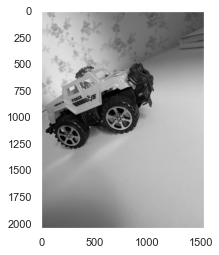

96


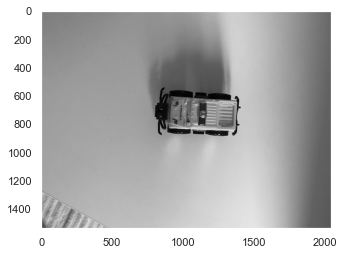

97


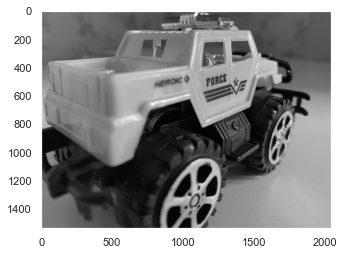

98


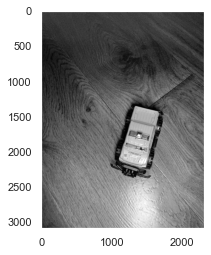

99


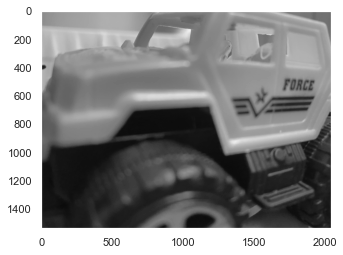

100


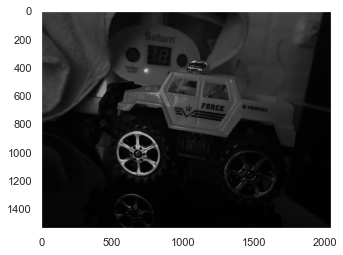

101


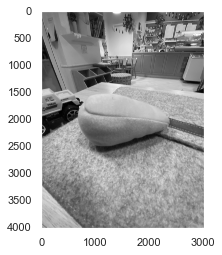

102


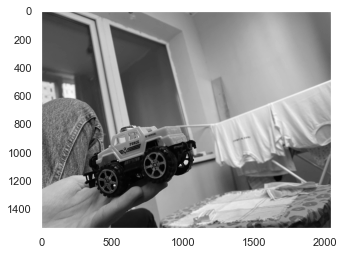

103


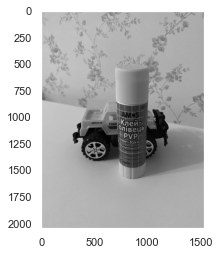

104


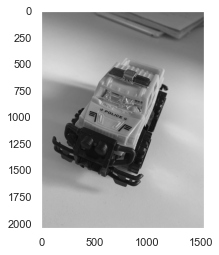

105


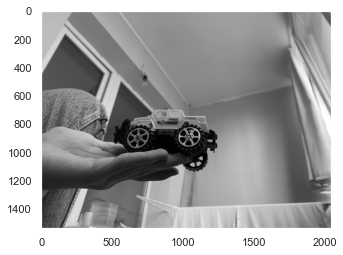

106


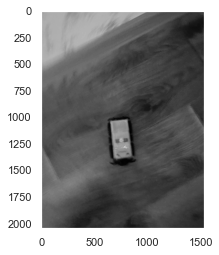

107


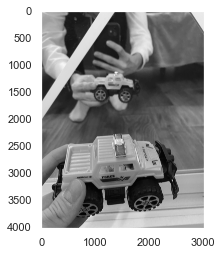

108


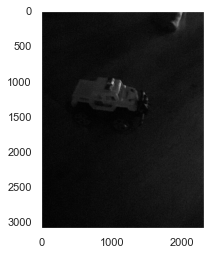

109


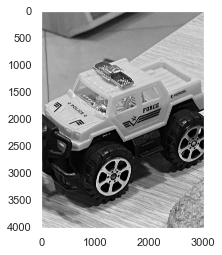

110


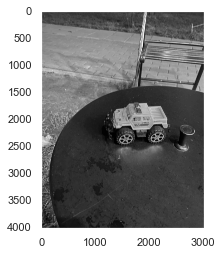

111


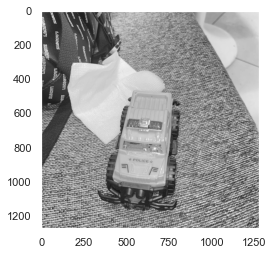

112


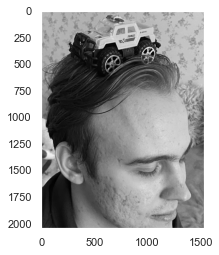

113


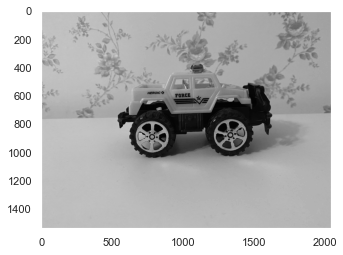

114


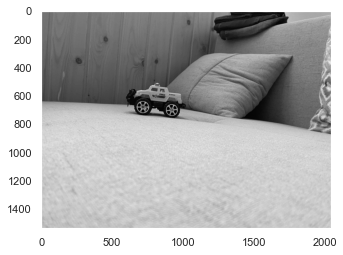

115


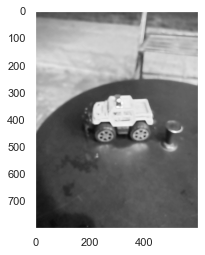

116


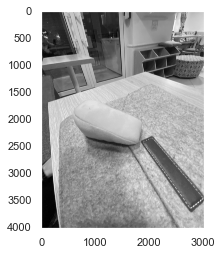

117


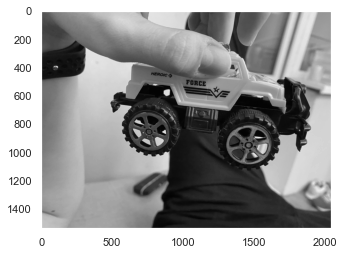

118


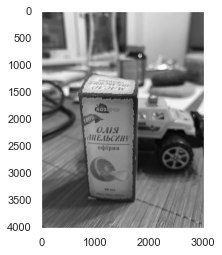

119


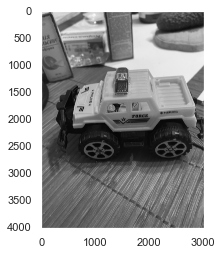

120


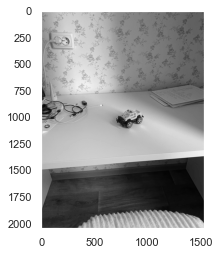

<Figure size 432x288 with 0 Axes>

In [21]:
sec_images = [cv2.imread(image,0) for image in sec_data_set]
sns.set()
with sns.axes_style({'axes.grid': False}):
    for idx, image in enumerate(sec_images): 
        print(idx)
        plt.imshow(sec_images[idx], 'gray'),plt.show()
        plt.figure(idx+1)

In [23]:
sec_inliers_matches = dict()

for im_j_idx in range(len(sec_images)):
    sec_inliers_matches["img"+str(im_j_idx)]=list()
    
sheet["A2"] = "algorithm"
sheet["B2"] = "property"
sheet["A3"] = "brisk"
sheet["B3"] = "inliers/matches"
sheet["C3"] = "distance MSE"
sheet["D3"] = "time (s)"
sheet["E3"] = "akaze"
sheet["F3"] = "inliers/matches"
sheet["G3"] = "distance MSE"
sheet["H3"] = "time (s)"
c = 3

for alg_name, alg in alg_dict.items():
    for im_i_idx, image_i in enumerate(sec_images):
            time_start=time.monotonic()
            _, __, match, inlier ,msd = detect_match(algorithm=alg,query_img=image_i,train_img=sec_images[41],
                                                         min_match_count=5)
            c = c + 1
            time_end=time.monotonic()
            if match==0:
                match=np.inf
            print(im_i_idx)
            sec_inliers_matches["img"+str(im_i_idx)].append(np.sum(inlier)/(len(match)))
            sec_inliers_matches["img"+str(im_i_idx)].append(msd)
            sec_inliers_matches["img"+str(im_i_idx)].append(time_end-time_start)
            if(alg_name == "brisk"):
                sheet[str("A"+str(c))] = str("img"+str(im_i_idx))
                sheet[str("B"+str(c))] = np.sum(inlier)/(len(match))
                sheet[str("C"+str(c))] = msd
                sheet[str("D"+str(c))] = time_end-time_start
            else:
                sheet[str("E"+str(c))] = str("img"+str(im_i_idx))
                sheet[str("F"+str(c))] = np.sum(inlier)/(len(match))
                sheet[str("G"+str(c))] = msd
                sheet[str("H"+str(c))] = time_end-time_start
            
workbook.save(filename="hello_world60.xlsx")



0
1
2
3
4


<ipython-input-23-ecf0816ba8a1>:28: RuntimeWarning: invalid value encountered in long_scalars
  sec_inliers_matches["img"+str(im_i_idx)].append(np.sum(inlier)/(len(match)))
<ipython-input-23-ecf0816ba8a1>:33: RuntimeWarning: invalid value encountered in long_scalars
  sheet[str("B"+str(c))] = np.sum(inlier)/(len(match))


5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
0
1
2
3


<ipython-input-23-ecf0816ba8a1>:38: RuntimeWarning: invalid value encountered in long_scalars
  sheet[str("F"+str(c))] = np.sum(inlier)/(len(match))


4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120


In [24]:
sec_comparison_df=pd.DataFrame(sec_inliers_matches,index=index)
sec_comparison_df

img0      img1      img2      img3      img4  \
algorithm property                                                            
brisk     inliers/matches  0.000000  0.384615  0.000000  0.000000       NaN   
          distance MSE          inf  0.526086       inf       inf       inf   
          time (s)         0.381378  0.591836  0.280686  0.243266  0.167918   
akaze     inliers/matches  0.000000  0.000000  0.000000       NaN       NaN   
          distance MSE          inf       inf       inf       inf       inf   
          time (s)         1.187294  2.825693  2.730782  1.022232  0.735997   

                               img5      img6      img7      img8      img9  \
algorithm property                                                            
brisk     inliers/matches  0.333333  0.172414  0.000000  0.666667       NaN   
          distance MSE     0.527525  0.529756       inf  0.500015       inf   
          time (s)         0.855963  0.868897  0.221369  0.454107  0.279222   
akaze     inliers/matches  0.363636  0.218750  0.000000  0.307692       NaN   
          distance MSE     0.553975  0.460752       inf  0.531166       inf   
          time (s)         2.973650  3.474898  1.284602  1.717654  2.879943   

                           ...    img111    img112    img113    img114  \
algorithm property         ...                                           
brisk     inliers/matches  ...  0.318182  0.666667  0.500000  0.368421   
          distance MSE     ...  0.545861  0.442284  0.402229  3.829485   
          time (s)         ...  2.078954  0.351147  0.304544  0.271981   
akaze     inliers/matches  ...  0.571429  0.608696  0.261905  0.416667   
          distance MSE     ...  0.500275  0.201001  0.645768  1.318592   
          time (s)         ...  1.316539  1.133706  1.131308  1.058808   

                             img115    img116    img117    img118    img119  \
algorithm property                                                            
brisk     inliers/matches       NaN  0.571429  0.500000  0.000000  0.171429   
          distance MSE          inf  0.522958  0.506691       inf  0.516847   
          time (s)         0.154841  0.512244  0.320405  0.286718  0.849688   
akaze     inliers/matches       NaN  0.333333  0.277778  0.000000  0.370370   
          distance MSE          inf  0.539608  0.523276       inf  0.278321   
          time (s)         0.710342  2.918130  1.144517  2.760383  3.041878   

                             img120  
algorithm property                   
brisk     inliers/matches  0.454545  
          distance MSE     3.285558  
          time (s)         0.590948  
akaze     inliers/matches  0.444444  
          distance MSE     0.675368  
          time (s)         1.123400  

[6 rows x 121 columns]

In [25]:
best_inliers = {descr:{int(k[3:]):np.round(v,2) for k,v in zip(
                sec_comparison_df.drop(columns=['img0']).loc[descr].sort_values(by=['inliers/matches'],axis=1,
                                    ascending=False).loc['inliers/matches'].index.values,
                 sec_comparison_df.drop(columns=['img0']).loc[descr].sort_values(by=['inliers/matches'],axis=1,
                                     ascending=False).loc['inliers/matches'].values) if v>=0.1} for descr in alg_dict.keys()}



In [28]:
def showresult2(id_image, algorithm):
    keypoints1, keypoints2, good_matches, matchesMask, _ = detect_match(algorithm=algorithm,query_img=sec_images[id_image],train_img=sec_images[19],
                                                     min_match_count=5)
    img3=plot_match(query_img=sec_images[id_image], keypoints1=keypoints1,train_img=sec_images[41],  keypoints2=keypoints2, good_matches=good_matches, matchesMask=matchesMask)
    plt.show(img3)

1
brisk


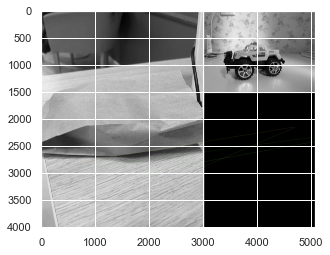

<Figure size 432x288 with 0 Axes>

1
akaze


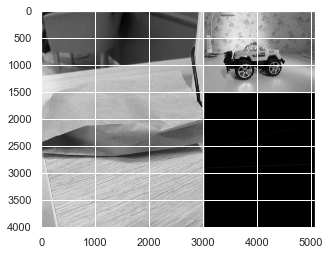

<Figure size 432x288 with 0 Axes>

5
brisk


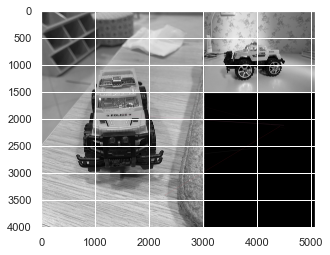

<Figure size 432x288 with 0 Axes>

5
akaze


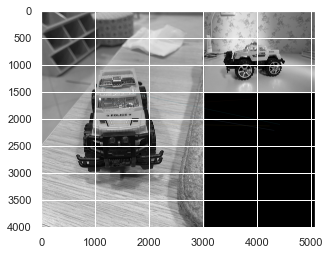

<Figure size 432x288 with 0 Axes>

6
brisk


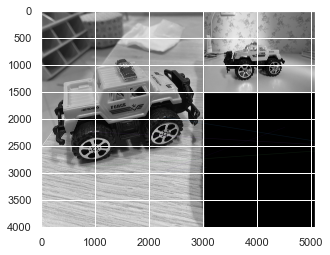

<Figure size 432x288 with 0 Axes>

6
akaze


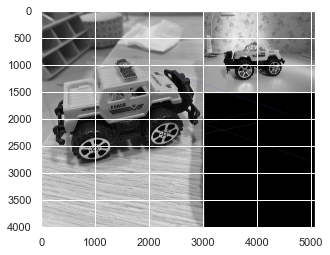

<Figure size 432x288 with 0 Axes>

8
brisk


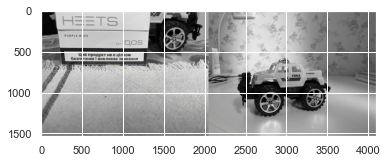

<Figure size 432x288 with 0 Axes>

8
akaze


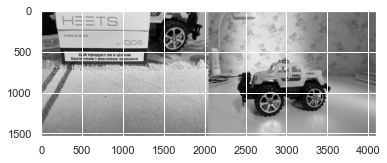

<Figure size 432x288 with 0 Axes>

10
brisk


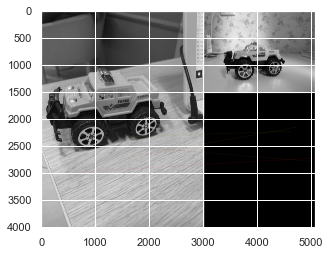

<Figure size 432x288 with 0 Axes>

10
akaze


KeyboardInterrupt: 

In [29]:
ids = set(best_inliers['akaze'].keys())
ids_2 = set(best_inliers['brisk'].keys())
diference = ids.difference(ids_2)
ids.update(best_inliers['brisk'].keys())
for i in ids:
    for alg_name, alg in alg_dict.items():
        print(i)
        print(alg_name)
        showresult2(i,alg) 

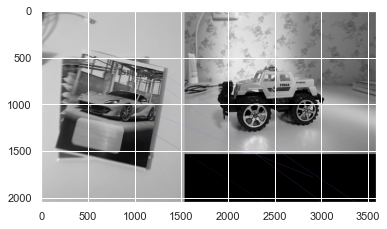

<Figure size 432x288 with 0 Axes>

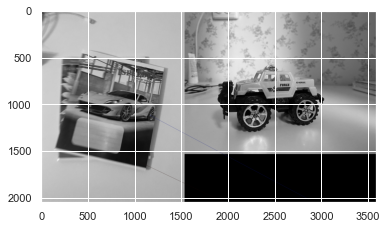

<Figure size 432x288 with 0 Axes>

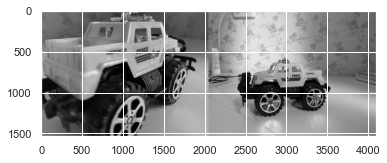

<Figure size 432x288 with 0 Axes>

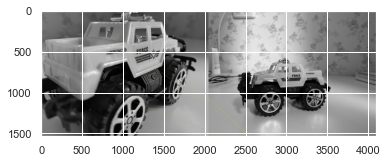

<Figure size 432x288 with 0 Axes>

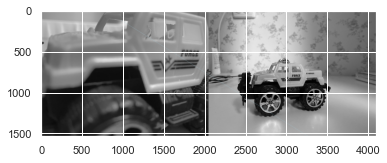

<Figure size 432x288 with 0 Axes>

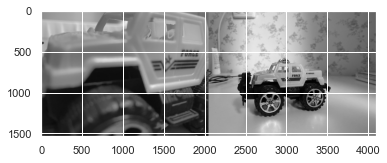

<Figure size 432x288 with 0 Axes>

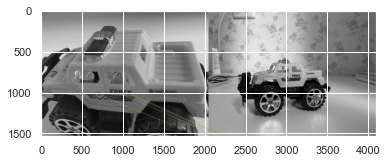

<Figure size 432x288 with 0 Axes>

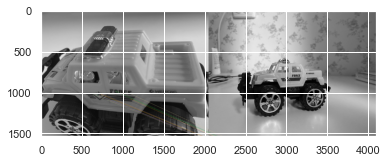

<Figure size 432x288 with 0 Axes>

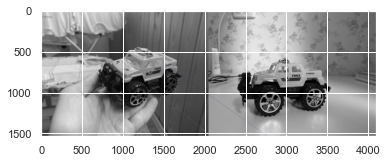

<Figure size 432x288 with 0 Axes>

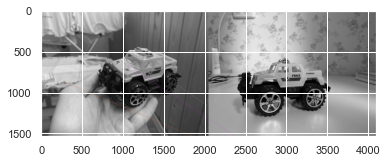

<Figure size 432x288 with 0 Axes>

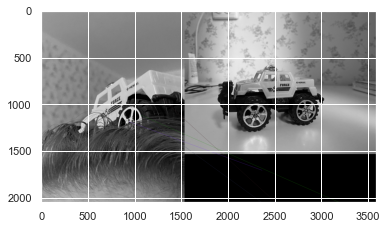

<Figure size 432x288 with 0 Axes>

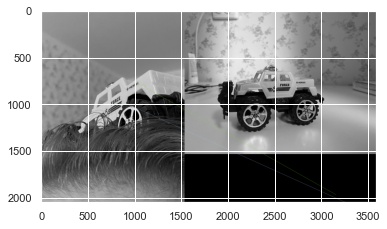

<Figure size 432x288 with 0 Axes>

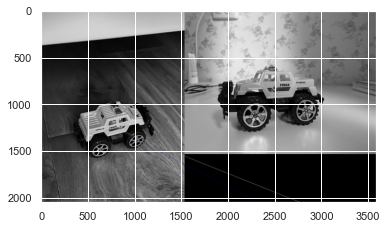

<Figure size 432x288 with 0 Axes>

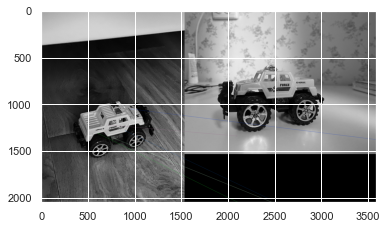

<Figure size 432x288 with 0 Axes>

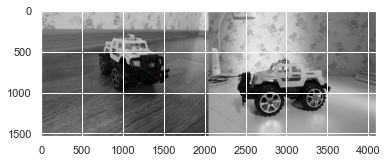

<Figure size 432x288 with 0 Axes>

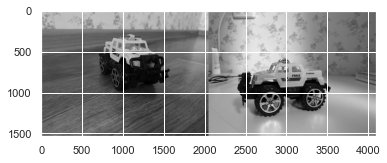

<Figure size 432x288 with 0 Axes>

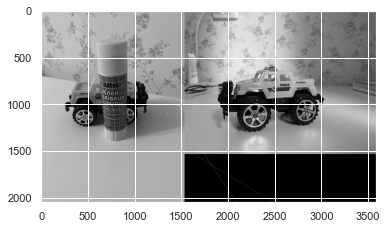

<Figure size 432x288 with 0 Axes>

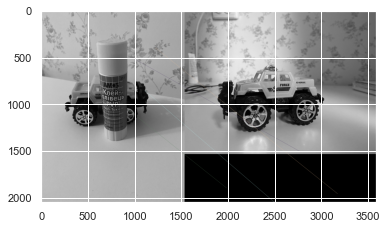

<Figure size 432x288 with 0 Axes>

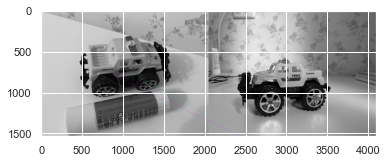

<Figure size 432x288 with 0 Axes>

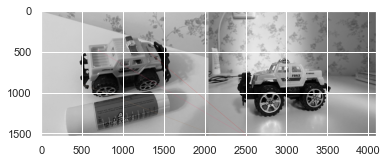

<Figure size 432x288 with 0 Axes>

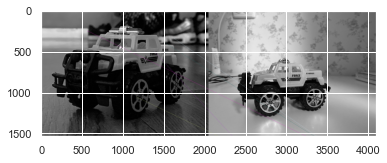

<Figure size 432x288 with 0 Axes>

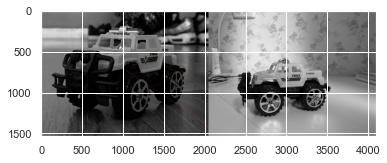

<Figure size 432x288 with 0 Axes>

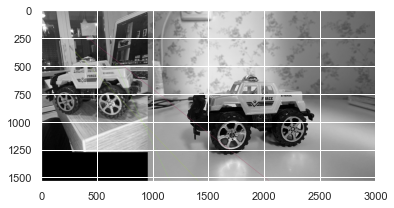

<Figure size 432x288 with 0 Axes>

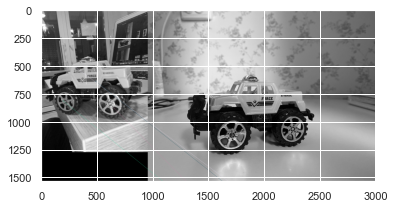

<Figure size 432x288 with 0 Axes>

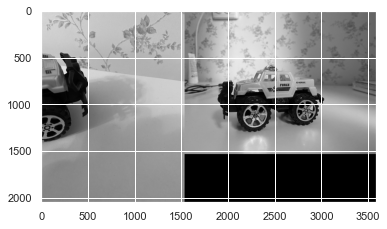

<Figure size 432x288 with 0 Axes>

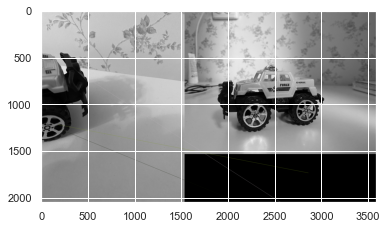

<Figure size 432x288 with 0 Axes>

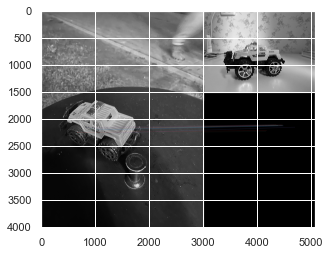

<Figure size 432x288 with 0 Axes>

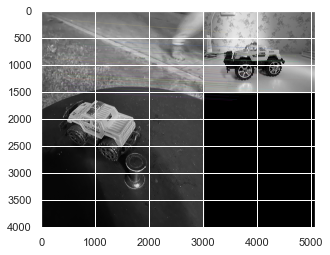

<Figure size 432x288 with 0 Axes>

In [30]:
for i in diference:
    for alg_name, alg in alg_dict.items():
        showresult2(i,alg) 

### Висновки
1. AKAZE краще за BRISK здатен впоратися з фото поганої якості або тими, що містять шуми, розмитими фото та в цілому точність виявлення є вищою.  Через особливості його структури, таких як пошук особливих точок на нелінійній багатомасштабній піраміді і опис дескрипторів по трьом параметрам, замість одного, як у BRISK, отримуємо високу точність при зіставленні зображень. Він є кращим для зображень зошита.
1. BRISK працює набагато швидше, тому за гарних умов фото його неодмінно можна вважати ефективнішим. BRISK відрізняється від інших методів тим, що він визначає найбільшу кількість особливих точок, але, на жаль, в них потрапляє і цифровий шум.
1. BRISK гарно спрацьовує з текстурами, об’ємними зображеннями, він показав себе краще за AKAZE на прикладі машинки.
1. При поворотах чи перекритті зображення обидва дескриптори показують себе добре.
1. Обидва дескриптори краще впоралися з зображеннями плоского предмета.

### Загалом ми очікували гірших результатів ніж отримали під час виконання роботи.
